# Import Essential Libraries

In [87]:
import numpy as np
import os
import sys
import timeit
import cv2
from scipy.signal import medfilt, medfilt2d
from scipy.ndimage import median_filter
import matplotlib as mlp
import seaborn as sns
import matplotlib.pyplot as plt
import pickle as pkl
%matplotlib inline
font = {'family' : 'sans-serif',
        'weight' : 'bold',
        'size'   : 18}

mlp.rc('font', **font)
#rcParams['font.sans-serif'] = ['Tahoma', 'DejaVu Sans', 'Lucida Grande', 'Verdana']
#from matplotlib import rcParams
#rcParams['font.family'] = 'sans-serif'
#rcParams['font.sans-serif'] = ['Tahoma']
#matplotlib.rcParams.update({'font.size': 22})

**`Timeit` is more accurate than `Time` library...**
https://stackoverflow.com/questions/17579357/time-time-vs-timeit-timeit

In [2]:
# Show the colored or Gray-Scale image.
def show_img(image, title, show_shape = True, shape = (10, 8), lim_enabled = True):
    if show_shape:
        print(f"The shape of {title} Image = {image.shape}")
    if image.ndim == 3:
        plt.figure(figsize=shape)
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB)); plt.axis("off"); plt.title(title); plt.show()
    elif image.ndim == 2:
        plt.figure(figsize=shape)
        if lim_enabled:
            plt.imshow(image, cmap = "gray", vmin = 0, vmax = 255); plt.axis("off"); plt.title(title); plt.show()
        else:
            plt.imshow(image, cmap = "gray"); plt.axis("off"); plt.title(title); plt.show()
    else:
        raise ValueError("Incorrect Dimension")

def plotter(nrows, ncols, img_lst, titles_lst, mode='RGB', figsize = (20, 20), lim_enabled = True):
    fig, ax = plt.subplots(nrows, ncols, figsize = figsize); k = 0
    for i in range(nrows):
        for j in range(ncols):
            if mode == 'RGB':
                if nrows == 1:
                    ax[j].imshow(cv2.cvtColor(img_lst[k], cv2.COLOR_BGR2RGB))
                    ax[j].axis("off")
                    ax[j].set_title(titles_lst[k])
                elif ncols == 1:
                    ax[i].imshow(cv2.cvtColor(img_lst[k], cv2.COLOR_BGR2RGB))
                    ax[i].axis("off")
                    ax[i].set_title(titles_lst[k])
                else:
                    ax[i, j].imshow(cv2.cvtColor(img_lst[k], cv2.COLOR_BGR2RGB))
                    ax[i, j].axis("off")
                    ax[i, j].set_title(titles_lst[k])
            else:
                if nrows == 1:
                    if lim_enabled:
                        ax[j].imshow(img_lst[k], cmap = "gray", vmin = 0, vmax = 255)
                    else:
                        ax[j].imshow(img_lst[k], cmap = "gray")
                    ax[j].axis("off")
                    ax[j].set_title(titles_lst[k])
                elif ncols == 1:
                    if lim_enabled:
                        ax[i].imshow(img_lst[k], cmap = "gray", vmin = 0, vmax = 255)
                    else:
                        ax[i].imshow(img_lst[k], cmap = "gray")
                    ax[i].axis("off")
                    ax[i].set_title(titles_lst[k])
                else:
                    if lim_enabled:
                        ax[i,j].imshow(img_lst[k], cmap = "gray", vmin = 0, vmax = 255)
                    else:
                        ax[i,j].imshow(img_lst[k], cmap = "gray")
                    ax[i, j].axis("off")
                    ax[i, j].set_title(titles_lst[k])
            k += 1
    fig.tight_layout(rect = [0,0,1,0.95])
    plt.show()

# Convert to GRAY scale
def gray(image): return cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Question 1

**(30 points)** You have already written codes for `median filtering`, `edge detection`, `contrast stretching` and `histogram equalization` for grayscale images. Now you are required to extend those codes to colorful RGB images using the methods discussed in the class.

## Question 1.1 - `medianFilter` on RGB image

Implement a function `medianFilter` which takes in an RGB image `im`, filter size $k$ and use it for the image `NoisySimba.png` and report the output.

In [4]:
# Define median filter to remove salt and pepper noise.
def medianFilter(image, kernel_shape):
    # For grayscale images i.e. 2D images.
    if image.ndim == 2:
        # Create an empty output array
        output = np.empty_like(image)
        #padding value
        p = kernel_shape//2
        #Zero Padding the image
        pad_img = np.zeros((image.shape[0] + (p+1), image.shape[1] + (p+1)))
        pad_img[p:-1,p:-1] = image
        #Applying median filter.
        for i in range(image.shape[0]):
            for j in range(image.shape[1]):
                output[i,j] = np.median(pad_img[i:i+k,j:j+k])
        return output.astype(np.uint8)
    elif image.ndim == 3: # For 3D Images...
        # Create an empty output array
        output = np.empty_like(image)
        # Apply recursion for 3D images
        output[..., 0] = medianFilter(image[..., 0], kernel_shape)
        output[..., 1] = medianFilter(image[..., 1], kernel_shape)
        output[..., 2] = medianFilter(image[..., 2], kernel_shape)
        return output
    else:
        raise ValueError("Check your Image dimensions...")

The shape of Noisy Simba Image = (1554, 2774, 3)


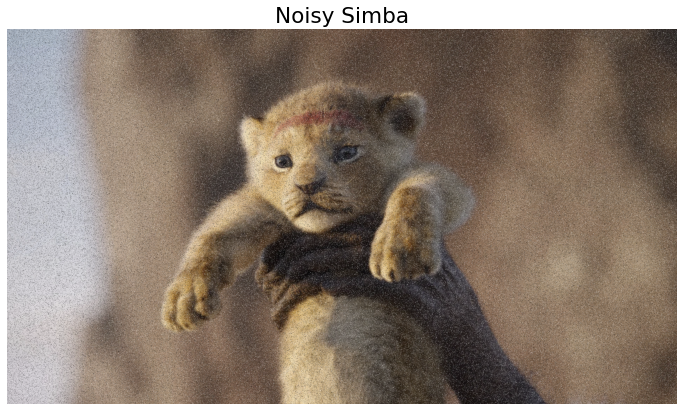

In [12]:
# import the image
simba = cv2.imread("../images/NoisySimba.png")

show_img(simba, "Noisy Simba", shape = (12, 10))

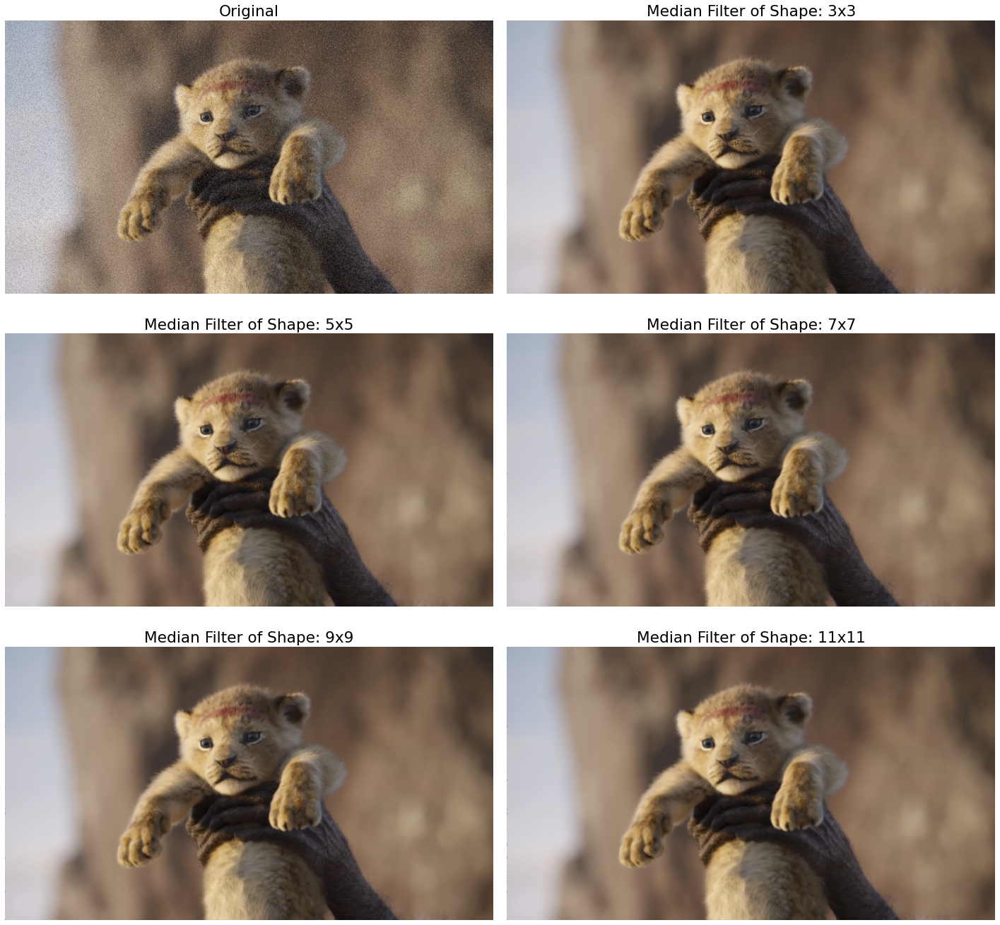

In [13]:
# Apply the Median Filter to the Image...
filter_shape = [3, 5, 7, 9, 11]; med_filtered = []
for k in filter_shape:
    med_filtered.append(medianFilter(simba, k))
# Insert the original image at 0th index.
med_filtered.insert(0, simba)
# Show all Images
plotter(3, 2, med_filtered, ["Original"]+[f"Median Filter of Shape: {k}x{k}" for k in filter_shape], mode='RGB')

**The best one as per to my observation is $5 \times 5$.**

## Question 1.2 - `colorLinContrastStretching` on RGB Image

Write a function `colorLinContrastStretching` which takes an image `im` as input and returns a contrast-enhanced version of the image. Apply the function on `fog.jpeg` and display your result.

https://amroamroamro.github.io/mexopencv/matlab/cv.cvtColor.html

In [4]:
def piecewiseLinTransform(im, coeffs, intervals):
    """
    Input:
        im: gray_scale image
        coeffs: list of lists -- two coeffs in a list
        intervals: list of intervals for each pair of coeffs
    Output:
        Transformed Image  
    """

    img = np.copy(im)  # prevent changes in orig array when call by reference is happening
    for i in range(img.shape[0]):
        for j in range(img.shape[1]):
            _, int_idx = interval_index(im[i][j], intervals)
            img[i][j] = np.uint8(coeffs[int_idx][0] * img[i][j] + coeffs[int_idx][1])
    return img

# Apply Linear Contrast Stretching CHANNEL by CHANNEL.

def basicContrastStretching(im, a, b, version = 1):
    """
    Input:
        im: Input image
        a: lower bound of our resulting image's intensity interval
        b: upper bound of our resulting image's intensity interval
        version: 1 or 2; 1 for simple method and 2 for truncation method.
    Output:
        An Image whose intensity ranges in [a, b]
    """
    temp_im = np.copy(im)  # to prevent in -function changes to array.
    if im.ndim == 2:
        gray_min = np.min(temp_im); gray_max = np.max(temp_im)
        if version == 1:
            # Transform gray Channel
            temp_im = np.round((temp_im - gray_min) * ((b-a)/(gray_max-gray_min)) + a)
            return temp_im
        elif version == 2:
            slow = eval(input("Enter by what % you want to trim pixel-axis from left: "))
            shigh = eval(input("Enter by what % you want to trim pixel-axis from right: "))
            gray_range = gray_max - gray_min
            # Redifining the range for RED channel
            gray_hat_min, gray_hat_max = round(gray_min + (slow/100)*gray_range + 1), round(gray_max - (shigh/100)*gray_range)
            # New slopes
            gray_slope = (b - a)/(gray_hat_max - gray_hat_min)
            # Coeffs
            coeffs_gray = [[0, a], [gray_slope, (a - gray_slope*gray_hat_min)], [0, b]]
            # Intervals
            intervals_gray = [[gray_min, gray_hat_min], [gray_hat_min, gray_hat_max], [gray_hat_max, gray_max + 1]]
            # Transform GRAY channel
            temp_im = piecewiseLinTransform(temp_im, coeffs_gray, intervals_gray)
            return temp_im
        else:
            raise ValueError("Ooops! Please Enter Correct Version. (Either 1 or 2)")
    # Apply for 3-Channel Image.
    elif im.ndim == 3:
        temp_im[..., 0] = basicContrastStretching(im[..., 0], a, b, version)
        temp_im[..., 1] = basicContrastStretching(im[..., 1], a, b, version)
        temp_im[..., 2] = basicContrastStretching(im[..., 2], a, b, version)
        return temp_im
    else:
        raise ValueError("Oops! Please Enter correct Image Mode.")

In [6]:
# Apply Contrast Stretching by Transforming RGB color-space to YC1C2.
def colorLinContrastStretching(im, lower_lim, upper_lim, version = 1):
    """Convert BGR to YC1C2 and then apply monochrome contrast stretching on Y channel and revert back."""
    #Convert to YC1C2 and extract Y channel.
    YC1C2 = cv2.cvtColor(im, cv2.COLOR_BGR2YCrCb)
    Y = YC1C2[..., 0]
    # Extract the minimum and maximum.
    gray_min, gray_max = np.min(Y), np.max(Y)
    
    if version == 1:
        # Transform gray Channel
        Y = np.clip((Y - gray_min) * ((b-a)/(gray_max-gray_min)) + a, 0, 255).astype(np.uint8)
        transYC1C2 = np.dstack([Y, YC1C2[..., 1], YC1C2[..., 2]])
        return cv2.cvtColor(transYC1C2, cv2.COLOR_YCrCb2BGR)
    elif version == 2:
        slow = eval(input("Enter by what % you want to trim pixel-axis from left: "))
        shigh = eval(input("Enter by what % you want to trim pixel-axis from right: "))
        gray_range = gray_max - gray_min
        # Redifining the range for RED channel
        gray_hat_min, gray_hat_max = round(gray_min + (slow/100)*gray_range + 1), round(gray_max - (shigh/100)*gray_range)
        # New slopes
        gray_slope = (b - a)/(gray_hat_max - gray_hat_min)
        # Coeffs
        coeffs_gray = [[0, a], [gray_slope, (a - gray_slope*gray_hat_min)], [0, b]]
        # Intervals
        intervals_gray = [[gray_min, gray_hat_min], [gray_hat_min, gray_hat_max], [gray_hat_max, gray_max + 1]]
        # Transform GRAY channel
        Y = np.clip(piecewiseLinTransform(Y, coeffs_gray, intervals_gray), 0, 255).astype(np.uint8)
        transYC1C2 = np.dstack([Y, YC1C2[..., 1], YC1C2[..., 2]])
        return cv2.cvtColor(transYC1C2, cv2.COLOR_YCrCb2BGR)
    else:
        raise ValueError("Ooops! Please Enter Correct Version. (Either 1 or 2)")

The shape of Fog Image = (500, 750, 3)


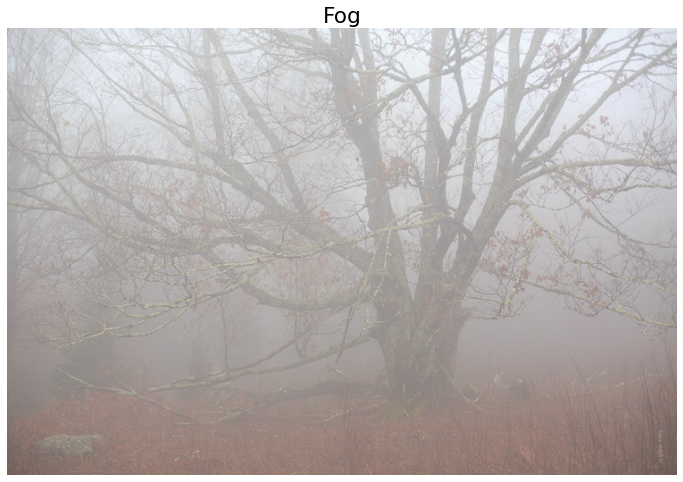

In [59]:
# Read the 'fog.jpeg'...
fog = cv2.imread("../images/fog.jpeg")
show_img(fog, "Fog", shape = (12, 10))

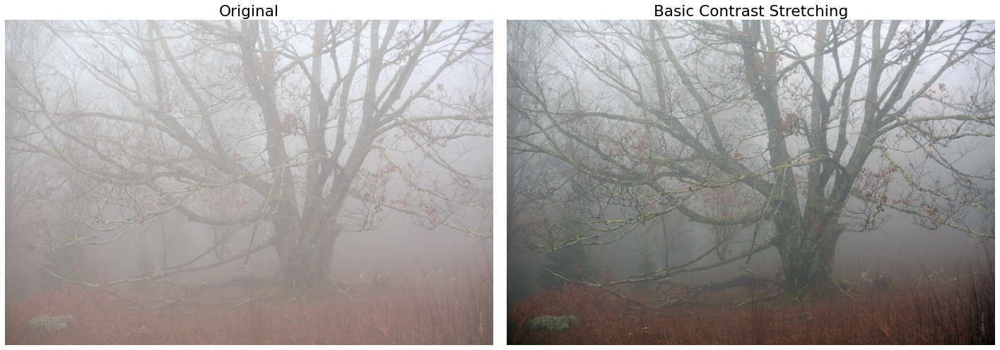

In [51]:
# Apply Linear Contrast Stretching...
a = 0
b = 255
fog_contrast = basicContrastStretching(fog, a, b)
plotter(1, 2, [fog, fog_contrast], ["Original", "Basic Contrast Stretching"], mode='RGB')

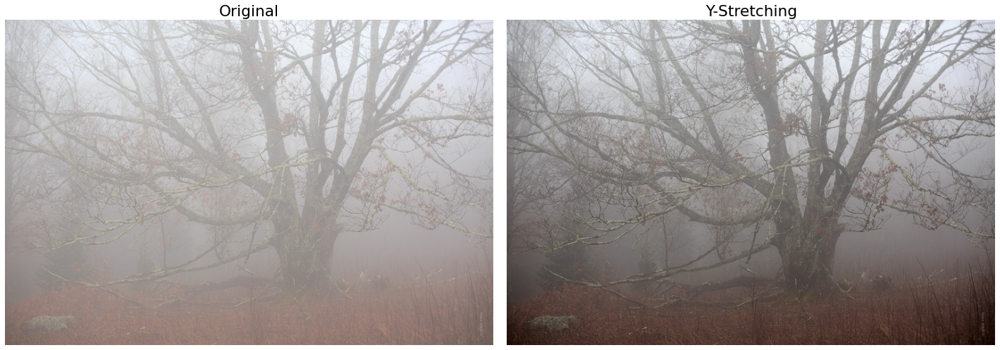

In [60]:
# Apply Channel Contrast Stretching...
a = 0
b = 255
fog_contrast = colorLinContrastStretching(fog, a, b)
plotter(1, 2, [fog, fog_contrast], ["Original", "Y-Stretching"], mode='RGB')

## Question 1.3 - `histEqualization` on RGB Image

Perform histogram equalization on the image `fog.jpeg` and show the result.

https://prateekvjoshi.com/2013/11/22/histogram-equalization-of-rgb-images/

https://stackoverflow.com/questions/15007304/histogram-equalization-not-working-on-color-image-opencv

https://www.opencv-srf.com/2018/02/histogram-equalization.html

https://towardsdatascience.com/histogram-equalization-a-simple-way-to-improve-the-contrast-of-your-image-bcd66596d815

In [62]:
def pixel_freq(im, bpp, prob = False):
    """
    Input:
        im: Image in form of an 2D array
        bpp: # of bits-per-pixel
        prob: A boolean that decides upon type of frequency output i.e., either probabilistic or integral.
    Output:
        Freuency of each pixel in the given image
    """
    freq_dict = {i:0 for i in range(2**bpp)}
    for i in im:
        for j in i:
            freq_dict[j] += 1
    tot_pixels = im.shape[0]*im.shape[1]
    if prob:
        return np.array([[k, (freq_dict[k]/tot_pixels)] for k in freq_dict])
    return np.array([[k, freq_dict[k]] for k in freq_dict])

def lookup_pixel_table(im, bpp, version = 1):
    """
    Input:
        img: A gray-scale image
        bpp: # of bits-per-pixel
        version: 1 or 2 
    Output:
        Look UP table (dictionary) for Histogram Equalization.
    """
    freq_arr = pixel_freq(im, bpp, prob = True)
    if version == 1:
        return {i:np.int32((2**bpp - 1)*np.sum(freq_arr[:(i+1), 1])) for i in range(2**bpp)}
    elif version == 2:
        cum_freq_arr = np.cumsum(freq_arr[:,1]); cdf_min = cum_freq_arr[np.argwhere(cum_freq_arr != 0)[0, 0]]
        return {i:np.int32((2**bpp - 1)*(cum_freq_arr[i] - cdf_min)/(1 - cdf_min)) for i in range(2**bpp)}
    else:
        raise ValueError("OOps! Please enter the Version Properly. It's either 1 or 2")

def histEqualization(img, bpp = 8, version = 2, color_format = "HSV"):
    """
    Input:
        img: A Color Image.
        bpp: # of bits-per-pixel
        version: 1 or 2 
        color_format: HSV or YCrCb
    Output:
        An image whose pixel's frequency distribution is approximately similar to UNIFORM distribution.
    """
    if color_format == "HSV":
        # Convert the BGR image to HSV format.
        transImg = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
        req_channel = transImg[..., 2]
    elif color_format == "YCrCb":
        # Convert the BGR image to Y-Cr-Cb format.
        transImg = cv2.cvtColor(img, cv2.COLOR_BGR2YCrCb)
        req_channel = transImg[..., 0]
    else:
        raise ValueError("Please input correct color format. For Help see __doc__ string.")
    im = np.copy(req_channel)# to avoid changes in original image
    hist_equalized_vals = lookup_pixel_table(im, bpp, version = version)
    for k in range(im.shape[0]):
        for j in range(im.shape[1]):
            im[k][j] = hist_equalized_vals[im[k][j]]
    if color_format == "HSV":
        return cv2.cvtColor(np.dstack([transImg[..., 0], transImg[..., 1], im]), cv2.COLOR_HSV2BGR)
    elif color_format == "YCrCb":
        return cv2.cvtColor(np.dstack([im, transImg[..., 1], transImg[..., 2]]), cv2.COLOR_YCrCb2BGR)

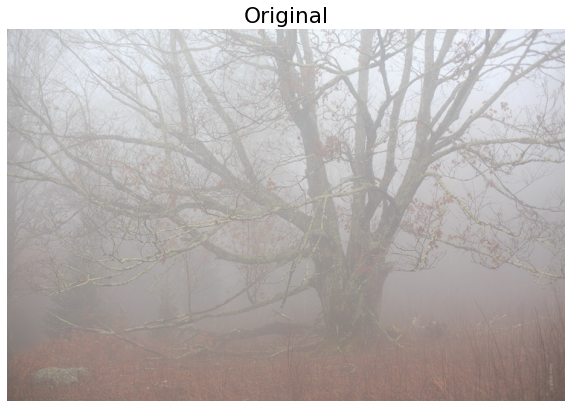

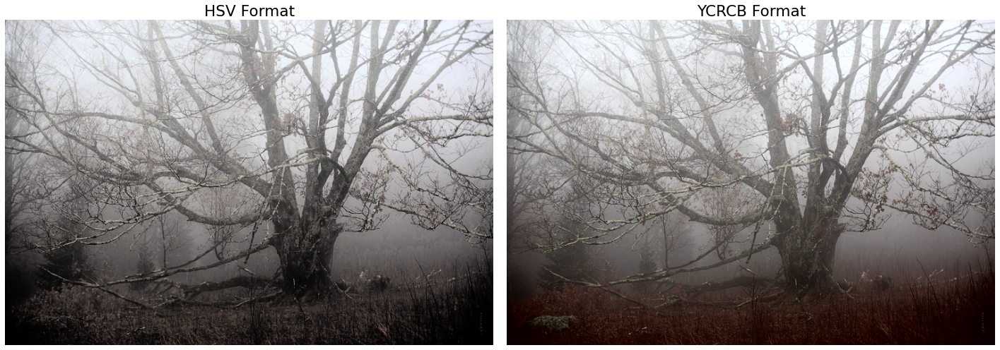

In [64]:
#Apply Histogram Equalization on Fog.
hist_equalized_hsv_fog = histEqualization(fog, color_format = "HSV")
hist_equalized_ycrcb_fog = histEqualization(fog, color_format = "YCrCb")
show_img(fog, "Original", show_shape = False, shape = (10, 8), lim_enabled = True)
plotter(1, 2, [hist_equalized_hsv_fog, hist_equalized_ycrcb_fog],\
        ["HSV Format", "YCRCB Format"], mode='RGB', figsize = (20, 20), lim_enabled = True)

## Question 1.4 - **Vintage**, **Matrix**, **Duo-Tone**, and **Vignette** on image of your choice.

Demonstrate "Vintage effect", "Matrix effect", "Vignetting" and "duo-tone" on any image of your choice.\
**Note**: You are allowed to use `cv2.LUT()` for duo-tone.

In [37]:
#Applying Vintage effect.
def vintage(im):
    """Returns the Vintage effect on a COLOR Image"""
    #Define Vintage Matrix...
    vintage_mat = np.array([[0.210, 0.769, 0.293], [0.188, 0.686, 0.249], [0.151, 0.534, 0.172]])
    # Construct Image matrix.
    im_mat = np.hstack([(im[..., 0]).flatten("C").reshape(-1, 1), (im[..., 1]).flatten("C").reshape(-1, 1),\
                       (im[..., 2]).flatten("C").reshape(-1, 1)]).T
    # Apply vintage map.
    out = np.dot(vintage_mat, im_mat).clip(0, 255).astype(np.uint8)
    # return the image.
    return np.dstack([out[k].reshape(im.shape[0], im.shape[1]) for k in range(3)])

# Applying Vignetting Effect.
def vignetting(im, texture):
    """
    im: Color or gray scale Image
    texture: The effect to be applied on 'im'
    Output the image with the desired effect.
    """
    if texture.ndim == 3:# if 3-Channel format change it to gray format.
        texture = gray(texture)
    # Resize the texture (= size of Image) and divide by 'max' entry to make all pixels lie between [0, 1]
    texture = cv2.resize(texture, (im.shape[1], im.shape[0]))
    texture = texture/np.max(texture)
    # Apply vignetting effect on each channel.
    if im.ndim == 2:
        return im*texture
    elif im.ndim == 3:
        return np.dstack([(im[..., k]*texture).astype(np.uint8) for k in range(3)])
    else:
        raise ValueError("Check Dimensions of Image!")


        
def MatrixEffect(img):
    ru= (np.asarray(img[:,:,0],dtype='float')/255)**(3/2)
    gu= (np.asarray(img[:,:,1],dtype='float')/255)**(4/5)
    bu= (np.asarray(img[:,:,2],dtype='float')/255)**(3/2)
    r = np.asarray(255*ru).clip(0, 255).astype(np.uint8)
    g = np.asarray(255*gu).clip(0, 255).astype(np.uint8)
    b = np.asarray(255*bu).clip(0, 255).astype(np.uint8)
    return np.dstack([r,g,b])

# Apply matrix effect.
def matrix_effect(im):
    """Convert Color Image to have effect of matrix movie."""
    param = [3/2, 4/5, 3/2]
    return np.dstack([255*((im[..., k]/255)**(param[k])).astype(np.uint8) for k in range(3)])

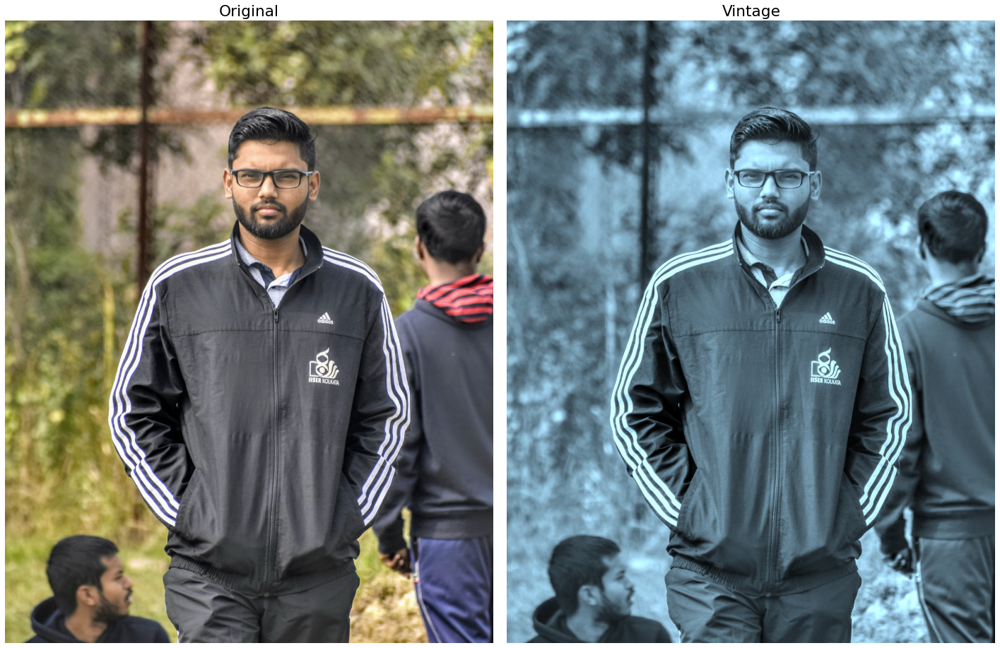

In [26]:
# Import the required Photo.
me = cv2.imread("../images/me.jpg")
#show_img(me, "MySelf", show_shape = True, shape = (12, 10), lim_enabled = True)

# Apply Vintage effect on Me.
me_vintage = vintage(me)
plotter(1, 2, [me, me_vintage], ["Original", "Vintage"], mode='RGB')

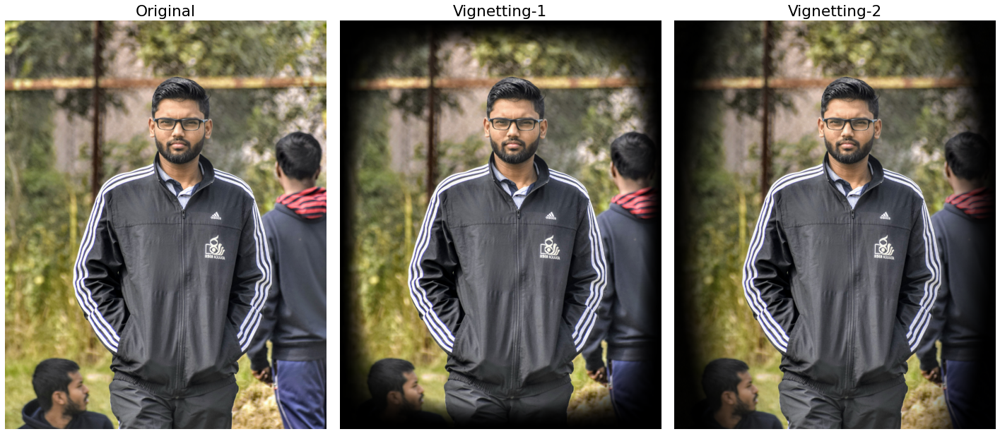

In [108]:
# Apply Vignetting effect on Me.
texture1 = cv2.imread("../images/texture2.jpeg")
me_vignetting = vignetting(me, texture1)
texture = cv2.imread("../images/texture.png")
me_vignetting_2 = vignetting(me, texture)
plotter(1, 3, [me, me_vignetting, me_vignetting_2], ["Original", "Vignetting-1", "Vignetting-2"], mode='RGB')

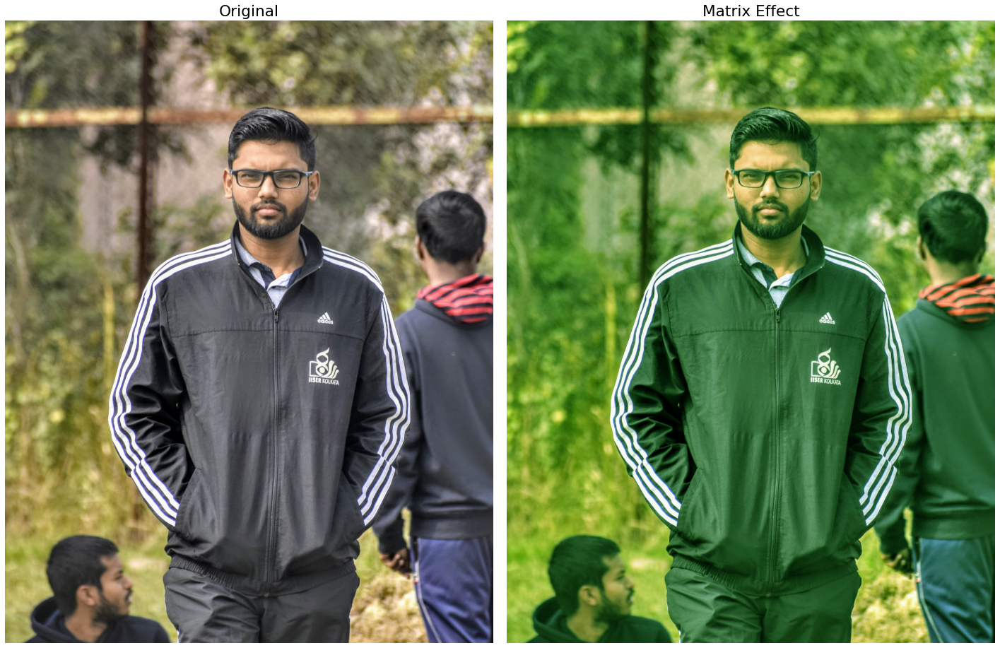

In [38]:
# Apply Matrix effect.
#me_matrix = matrix_effect(me)
me_matrix = MatrixEffect(me)
plotter(1, 2, [me, me_matrix], ["Original", "Matrix Effect"], mode='RGB')

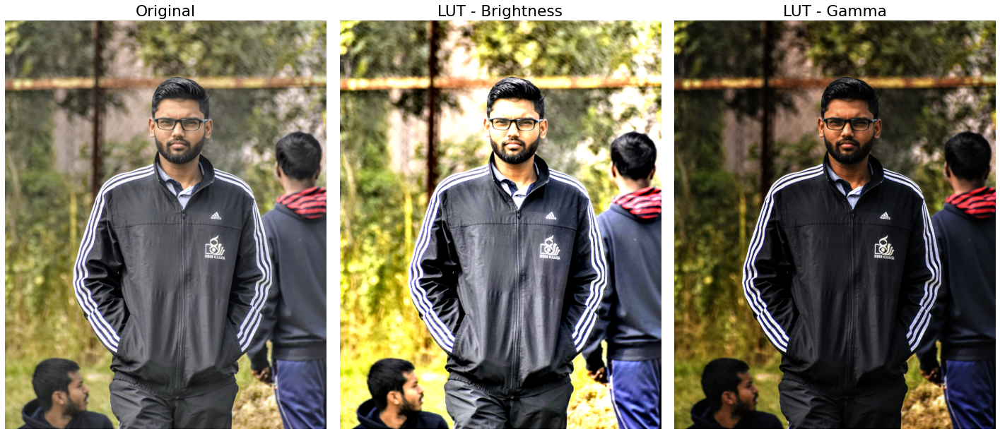

In [120]:
# Apply cv2.LUT() on me.
# contrast_factor (float): How much to adjust the contrast. Can be any non negative number. 
# 0 gives a solid gray image, 1 gives the original image while 2 increases the contrast by a factor of 2.
contrast_factor = 2
lut = np.array([ (i-74)*contrast_factor+74 for i in range (0,256)]).clip(0,255).astype('uint8')
me_LUT_bright = cv2.LUT(me, lut)
gamma = 2
gamma_table = np.array([np.power(x / 255.0, gamma)*255.0 for x in range(256)]).astype('uint8')
me_LUT_gamma = cv2.LUT(me, gamma_table) 
plotter(1, 3, [me, me_LUT_bright, me_LUT_gamma], ["Original", "LUT - Brightness", "LUT - Gamma"], mode='RGB')

# Question 2

## Question 2.1 - Segment + Components

**(20 points)** Find the cell organs of interest in the image `cell.png`. Use the same code to show your outputs on `flower.jpeg`.

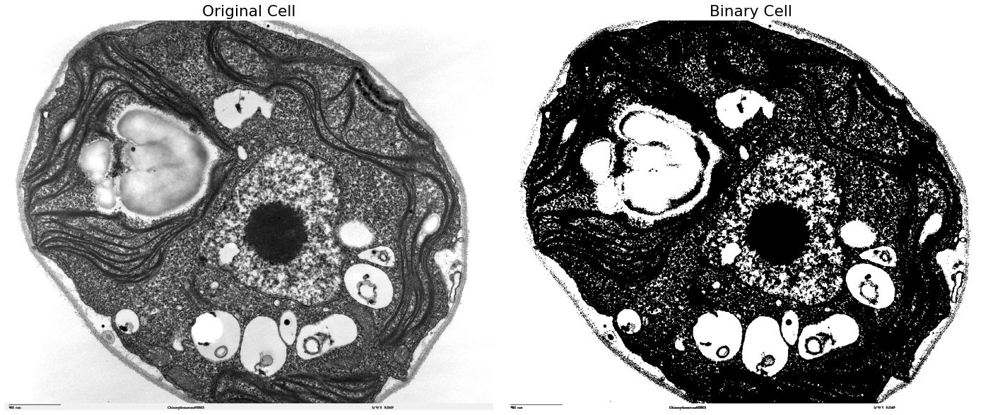

In [3]:
# Apply the Thresholding on Gray level Image.
# Import cell.png image.
cell = gray(cv2.imread("../images/cell.png"))
# Apply Thresholding on Above Cell
_, cell_binary = cv2.threshold(cell, 150, 255, cv2.THRESH_BINARY)
#Plot the Images.
plotter(1, 2, [cell, cell_binary], ["Original Cell", "Binary Cell"], mode='GRAY')

1. **Seeing the `white-dots` (and some black-dots), it's the first thing that comes to our mind is to remove them we can use `median` filter. But there is some limitation to that because the result we'll be obtaining would be smoothed (detailing would be lost somewhat).**
2. **To tackle this we an use Morphological Processing - `Erosion` or `Opening` (opening being more suitable). That way we can bridge the white-holes (or in other words erode them as they are foreground pixels) without losing details.**

In [3]:
# Define erosion, dilation, closing, and opening operations...
def erosion(image, se):
    """
    Apply 'se' = structuring element on the given Image
    --> Image format should be binary in nature. 1 denoting foreground and 0 as background.
    --> In 'se' set the active region (the desired shape) as 1, Origin as 2 and rest as 0.
    """
    img_n, img_m = image.shape
    se_n, se_m = se.shape
    # Also make a copy of image and transorm that, as if we transform the original one, it will affect the
    # downlying pixels as count of 1's and 0's are changing.
    im_copy = np.zeros_like(image, dtype = 'uint8')
    req_thresh = np.sum(se)
    # x_cord and y_cord of Origin.
    cord = np.where(se == 2)
    # No padding is required here.
    for i in range(img_m - se_m + 1):
        for j in range(img_n - se_n + 1):
            # Check if SE totally fits in Foreground...
            if np.sum(se*image[j:j+se_n, i:i+se_m]) == req_thresh:
                (im_copy[j:j+se_n, i:i+se_m])[cord[0][0], cord[1][0]] = 1
    return im_copy

# Define Dilation...
def dilation(image, se):
    """
    Apply 'se' = structuring element on the given Image
    --> Image format should be binary in nature. 1 denoting foreground and 0 as background.
    --> In 'se' set the active region (the desired shape) as 1, Origin as 2 and rest as 0.
    """
    img_n, img_m = image.shape
    se_n, se_m = se.shape
    # Filp SE around (0,0) coordinate.
    se = np.fliplr(np.flipud(se))
    # Also make a copy of image and transorm that, as if we transform the original one, it will affect the
    # downlying pixels as count of 1's and 0's are changing.
    im_copy = np.copy(image)
    # Patch that will be used in OR operation with Image Patch.
    tmp_patch = np.copy(se); cord = np.where(tmp_patch == 2)
    # Set the x_cord, y_cord of temporary SE as 1 -- will be used in OR operation.
    tmp_patch[cord[0][0], cord[1][0]] = 1
    # No padding is required here.
    for i in range(img_m - se_m + 1):
        for j in range(img_n - se_n + 1):
            # Check if the Origin intersects with the Foreground, if yes then 
            if (image[j:j+se_n, i:i+se_m])[cord[0][0], cord[1][0]] == 1:
                # This is basically a Logical OR operation between SE and Image Patch.
                im_copy[j:j+se_n, i:i+se_m] = np.logical_or(image[j:j+se_n, i:i+se_m], tmp_patch).astype(np.uint8)
    return im_copy

#Define Opening...
# It can be defined as composition of Erosion then Dilation.
# But to save computation time we can implement in a separate method.
def opening(image, se):
    """
    Apply 'se' = structuring element on the given Image
    --> Image format should be binary in nature. 1 denoting foreground and 0 as background.
    --> In 'se' set the active region (the desired shape) as 1, Origin as 2 and rest as 0.
    """
    img_n, img_m = image.shape
    se_n, se_m = se.shape
    # Also make a copy of image and transorm that, as if we transform the original one, it will affect the
    # downlying pixels as count of 1's and 0's are changing.
    im_copy = np.zeros_like(image, dtype = 'uint8')# Then put ones in it where required.
    req_thresh = np.sum(se)
    # Patch that will be used in OR operation with Image Patch.
    tmp_patch = np.copy(se); cord = np.where(tmp_patch == 2)
    # Set the x_cord, y_cord of temporary SE as 1 -- will be used in OR operation.
    tmp_patch[cord[0][0], cord[1][0]] = 1
    # No padding is required here.
    for i in range(img_m - se_m + 1):
        for j in range(img_n - se_n + 1):
            if np.sum(se*image[j:j+se_n, i:i+se_m]) == req_thresh:
                # This is basically an Logical XOR operation between SE and Image Patch.
                im_copy[j:j+se_n, i:i+se_m] = np.logical_or(image[j:j+se_n, i:i+se_m], tmp_patch).astype(np.uint8)
    return im_copy

# Define Closing...
# It can be defined as composition of Dilation then Erosion.
# OR it can be defined DUAL of OPENING.
def closing(image, se):
    """
    Apply 'se' = structuring element on the given Image
    --> Image format should be binary in nature. 1 denoting foreground and 0 as background.
    --> In 'se' set the active region (the desired shape) as 1, Origin as 2 and rest as 0.
    """
    # We will take the DUAL operation to define closing.
    # reflected version of SE
    se = np.fliplr(np.flipud(se))
    # Take complement of Binary Image.
    image_comp = np.logical_not(image).astype(np.uint8)
    # take complement of opening of above two.
    return np.logical_not(opening(image_comp, se)).astype(np.uint8)

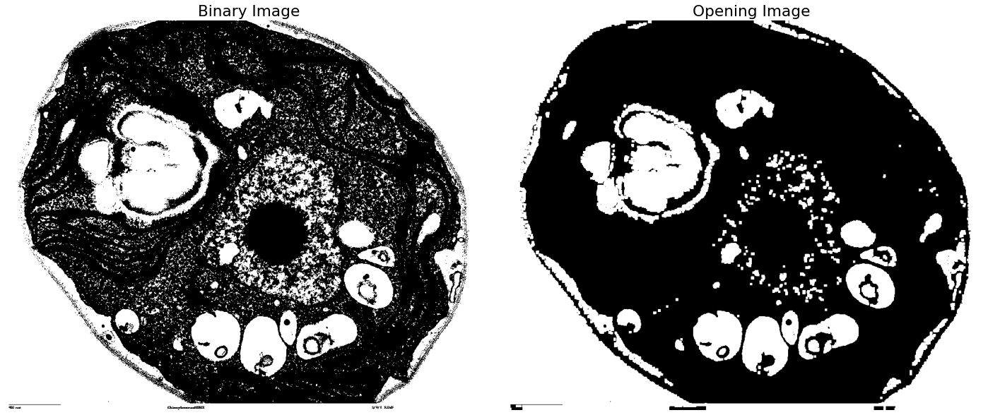

In [6]:
# Convert the binary image to 0's and 1's.
cell_binary1 = (cell_binary/255).astype(np.uint8)
# Define SE to be used for 7*7 SEs
box_se = np.ones((5, 5), dtype="uint8"); box_se[2, 2] = 2
# Perform Opening.
cell_binary_new = opening(cell_binary1, box_se)
plotter(1, 2, [cell_binary, cell_binary_new*255], ["Binary Image", "Opening Image"], mode='GRAY')

**Now perform `segmentation` and `count` the segments and color those segments as well.**

In [42]:
# Define Flood-Fill algorithm.
def floodFill(components, label, i, j, connectivity = 8):
    """A recursive function to find components of a binary image
    Connectivity: How many neighbors to consider.
    label: label to be given to the current component
    """
    # If the current pixel is colored with Old Foreground Color (= white)
    if components[i, j] == -1:# and img[i, j] == img[m, n]
        components[i, j] = label
        if connectivity == 8:
            for m in range(max(0, i-1), min(components.shape[0], i+2)): 
                # checking for boundaries of img.
                for n in range(max(0, j-1), min(components.shape[1], j+2)):
                    floodFill(components, label, m, n, connectivity = connectivity)
        elif connectivity == 4:
            m_upper, m_lower = max(0, i-1), min(i+1, components.shape[0])
            # bound on i and j according to image width and height.
            n_left, n_right = max(0, j-1), min(j+1, components.shape[1])
            floodFill(components, label, m_upper, j, connectivity = connectivity)
            floodFill(components, label, i, n_right, connectivity = connectivity)
            floodFill(components, label, m_lower, j, connectivity = connectivity)
            floodFill(components, label, i, n_left, connectivity = connectivity)
        else:
            raise ValueError("Oops! Please enter correct connectivity Value.")

            
# Stacking flood fill.
def stackFloodFill(components, label, i, j, connectivity = 8):
    """Build stacks manually and colour it."""
    #Initiate stack
    stack = [(i, j)]
    # check for connectivity type:
    while len(stack) > 0:
        x, y = stack.pop()
        # Check for x dimension
        if x<0 or x>=components.shape[0]:
            continue
        # Check for y dimension
        if y<0 or y>=components.shape[1]:
            continue
        # Check for Foreground pixel.
        if components[x, y] == -1:
            components[x, y] = label
            stack.append((x-1, y))
            stack.append((x, y-1))
            stack.append((x+1, y))
            stack.append((x, y+1))
            if connectivity == 8: # For 8 connectivity
                stack.append((x+1, y+1))
                stack.append((x+1, y-1))
                stack.append((x-1, y+1))
                stack.append((x-1, y-1))
        
# Define function to compute "Connected Components".
def compute_connected_components(binary_im, connectivity = 8, mode = "recursive", label = 0):
    """
    inut: A binary Image with 0's and 1's as entry
    Detect all isolated fore-ground regions (or components).
    And return the colored components of those foreground regions.
    """
    # maximum recursion limit
    sys.setrecursionlimit(30000)
    # Set Initial Label as -1 (and components index will start from 0)
    components = np.ones_like(binary_im) * (-1)
    # Setting the foreground as -1 and with looping will update that.
    components *= binary_im
    if mode == "recursive":
        # Iterate through all pixels.
        for i in range(binary_im.shape[0]):
            for j in range(binary_im.shape[1]):
                if components[i, j] == -1:
                    label = label + 1
                    floodFill(components, label, i, j, connectivity = connectivity)
    else:
        # Iterate through all pixels.
        for i in range(binary_im.shape[0]):
            for j in range(binary_im.shape[1]):
                if components[i, j] == -1:
                    label = label + 1
                    stackFloodFill(components, label, i, j, connectivity = connectivity)
    # Count total no. of components
    cnt = np.max(components)
    return cnt, components    

In [43]:
def plot_connected_components(components, title, figsize = (12, 10)):

    # Map component labels to hue val
    label_hue = np.uint8(179*components / np.max(components))
    blank_ch = 255*np.ones_like(label_hue)
    labeled_img = cv2.merge([label_hue, blank_ch, blank_ch])

    # cvt to BGR for display
    labeled_img = cv2.cvtColor(labeled_img, cv2.COLOR_HSV2BGR)

    # set bg label to black
    labeled_img[label_hue<=0] = 0
    
    # Set the figure size.
    plt.figure(figsize=figsize)
    plt.imshow(labeled_img); plt.axis("off"); plt.title(title); plt.show()

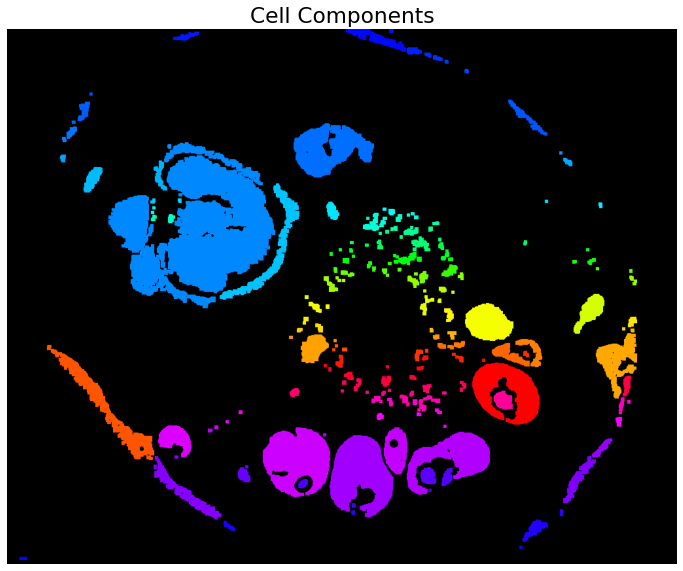

In [16]:
# Apply it on cell_binary_new.
tot_components, segmented_img = compute_connected_components(cell_binary_new, connectivity = 4,\
                                                             mode = "iterative", label = -1)

plot_connected_components(segmented_img, title = "Cell Components")

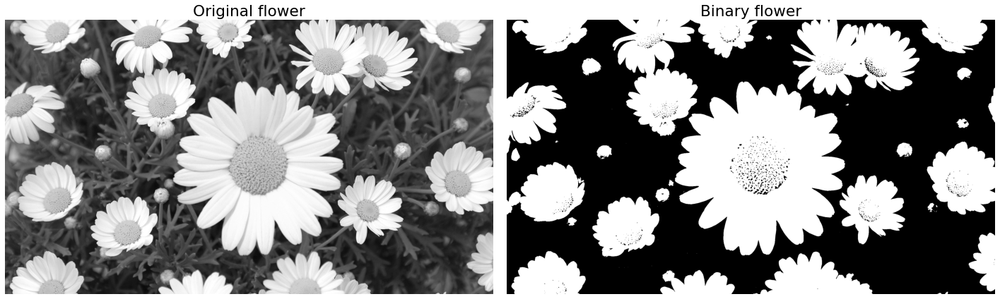

In [14]:
# Applying the same on flower.jpeg

# Apply the Thresholding on Gray level Image.
# Import flower.jpeg image.
flower = gray(cv2.imread("../images/flower.jpeg"))
# Apply Thresholding on Above flower
_, flower_binary = cv2.threshold(flower, 150, 255, cv2.THRESH_BINARY)
#Plot the Images.
plotter(1, 2, [flower, flower_binary], ["Original flower", "Binary flower"], mode='GRAY')

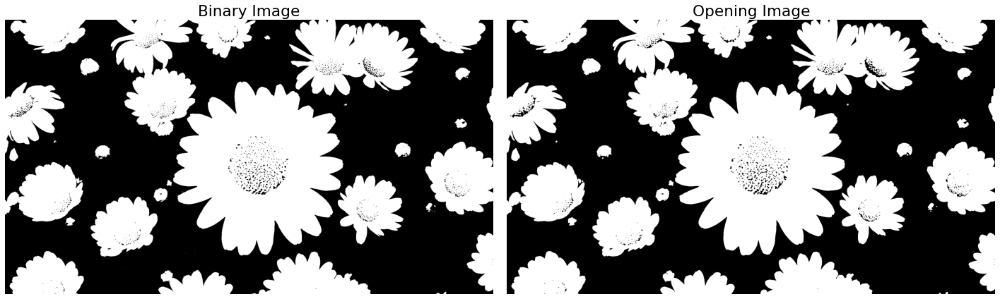

In [15]:
# Convert the binary image to 0's and 1's.
flower_binary1 = (flower_binary/255).astype(np.uint8)
# Define SE to be used for 7*7 SEs
box_se = np.ones((5, 5), dtype="uint8"); box_se[2, 2] = 2
# Perform Opening.
flower_binary_new = opening(flower_binary1, box_se)
plotter(1, 2, [flower_binary, flower_binary_new*255], ["Binary Image", "Opening Image"], mode='GRAY')

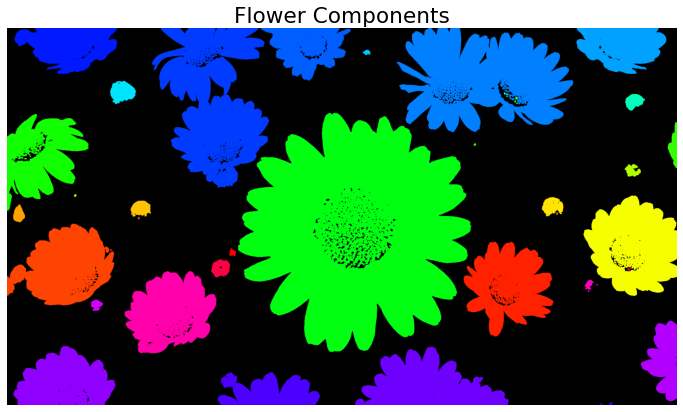

In [17]:
# Apply it on flower_binary_new.
_, segmented_img_fl = compute_connected_components(flower_binary_new, connectivity = 4,\
                                                             mode = "iterative", label = 0)

plot_connected_components(segmented_img_fl, title = "Flower Components")

## Question 2.2 - Counting Holes

**(20 points)** Read in the binary image `objects.png` and write a script which uses the image as input and answers the following questions.

1. How many objects have one or more holes?

The shape of Objects Image = (331, 384)


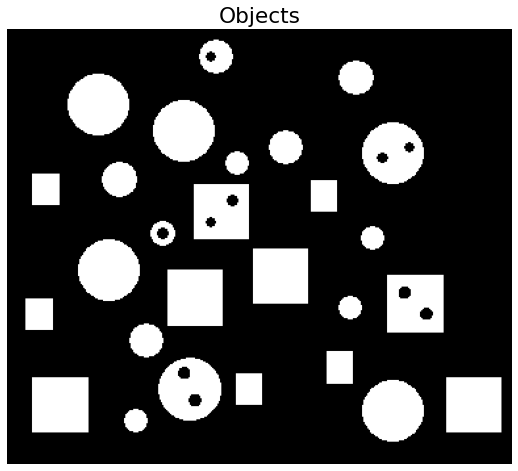

In [90]:
# Import the objects.png.
objects = gray(cv2.imread("../images/objects.png"))
show_img(objects, "Objects", show_shape = True, shape = (10, 8), lim_enabled = True)
# Apply thresholding.
_, objects_binary = cv2.threshold(objects, 150, 255, cv2.THRESH_BINARY)
objects_binary = (objects_binary/255).astype("uint8")

In [82]:
def filter_components(components, indices):
    """
    # Returns an array of size same as components array, but filter out a specific numbered 
    component(s) (given by 'indices' = index for connected components) by putting ones and elsewhere zeros.
    """
    # Initialize a zero array.
    res = np.zeros_like(components)
    # if multiple indices are there, then res will contain multiple components/objects.
    if type(indices) == np.ndarray:
        for idx in indices:
            res = res + (components == idx).astype("uint8")
    else:
        res = res + (components == indices).astype("uint8")
    return res.astype("uint8")

In [150]:
def detect_holes(components, show = True):
    """
    Objects with holes after "Closing" operation becomes larger in size.
    Input: components
    Intermediate STep: All objects in the Binary Image. Objects = list of 2D arrays that shows 
    1 where object lies and 0 elsewhere.
    show: boolean = Whether to show plot of holed components.
    Output: Objects that have grown in size.
    """
    # Convert components into individual objects.
    tot_components = np.max(components) # total number of components.
    # Obtain the objects.
    objects = [filter_components(components, idx) for idx in range(1, tot_components+1)]
    # area before closing.
    area_before_closing = np.array([obj.sum() for obj in objects])
    # Apply Closing on Objects.
    box_se = np.ones((5, 5), dtype="uint8"); box_se[2, 2] = 2 # Define 5*5 SEs
    closed_objects = [closing(obj, box_se) for obj in objects]
    # Calculate area after closing.
    area_after_closing = np.array([obj.sum() for obj in closed_objects])
    # Check at which place object has grown in size.
    indices_for_grown_obj = np.argwhere(area_after_closing > area_before_closing).ravel()
    # show the Plot.
    if show:
        final_structure = filter_components(components, indices_for_grown_obj + 1)
        plt.figure(figsize = (12, 10))
        plt.imshow(final_structure*255, cmap = "gray")
        plt.title(f"# Holed Objects = {len(indices_for_grown_obj)}"); plt.axis("off"); plt.show()
    # Return those objects.
    return indices_for_grown_obj, objects

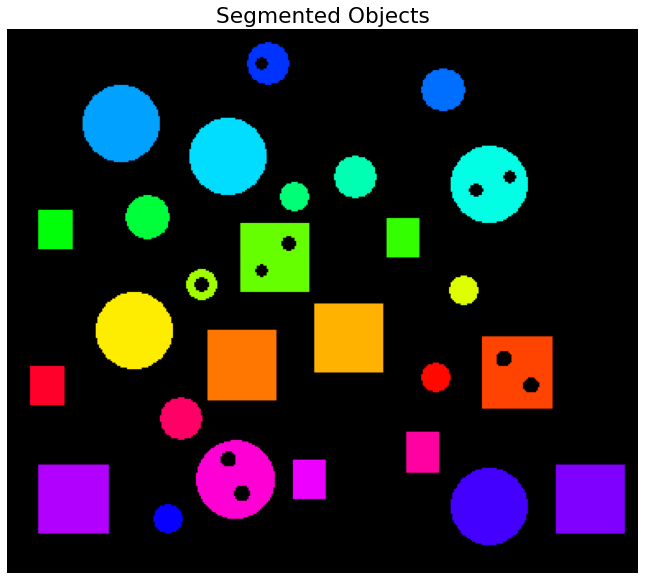

In [93]:
_, components = compute_connected_components(objects_binary)
plot_connected_components(components, title = "Segmented Objects")

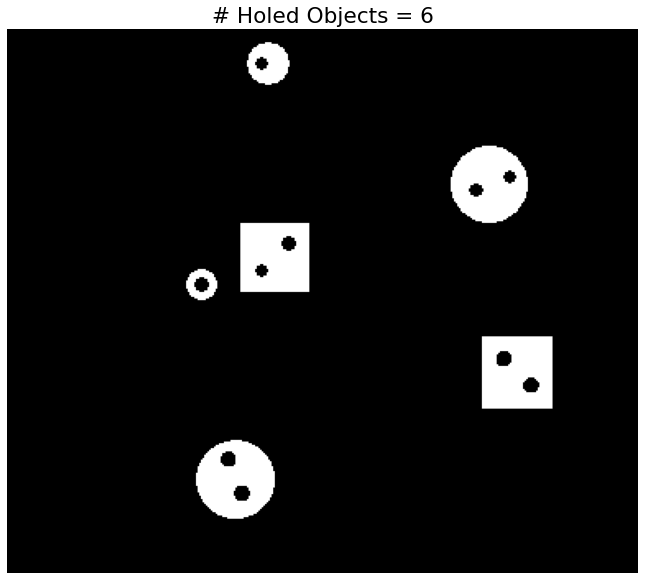

In [97]:
_, _ = detect_holes(components, show = True)

2. How many square objects are in the image?

In [151]:
# define compare SE with Object.
def compare_se_obj(window, se):
    """Compare the SE with Object."""
    for i in range(se.shape[0]):
        for j in range(se.shape[1]):
            if se[i, j] == -1:
                continue
            if se[i, j] != window[i, j]:
                return False
    return True

# Function to detect Corners.
def detect_corners(obj, SE):
    """
    Given an Object, find corner corresponding to the SE (Structuring Element) given.
    Input: obj, SE. (Obj should have one shape element)
    output: Corners position in an array (same size as that of obj), 
    where corner-position is highlighted as 1 and rest 0.
    """
    se = np.copy(SE)
    # se size.
    se_size = se.shape[0]
    pad = se_size//2
    # Find position of Structuring Element.
    m, n = np.argwhere(se == 2).ravel()
    se[m, n] = 1 # unless it would create a problem while comparing window with SE.
    # Pad the obj accordingly.
    padded_obj = np.zeros((obj.shape[0] + (2*pad), obj.shape[1] + (2*pad)))  
    padded_obj[pad:-pad, pad:-pad] = obj
    # define output array.
    res = np.zeros_like(padded_obj)
    # Traverse through obj to find the pattern same as SE.
    for i in range(obj.shape[0]):# iterating through obj shape will ensure that kernel won't override.
        for j in range(obj.shape[1]):
            window = padded_obj[i:(i + se_size), j:(j + se_size)]
            if compare_se_obj(window, se):
                res[i+m, j+n] = 1
    # return the output.
    return res[pad:-pad, pad:-pad]

# Function to detect Squares.
def detect_squares(components, show = True):
    """Detect squares."""
    # Convert components into individual objects.
    tot_components = np.max(components) # total number of components.
    # Obtain the objects.
    objects = [filter_components(components, idx) for idx in range(1, tot_components+1)]
    # Close them to remove discrepancies.
    SE = np.ones((9, 9), dtype="uint8"); SE[4, 4] = 2 # Define 9*9 SEs (large enough to fill holes)
    closed_obj = [closing(obj, SE) for obj in objects]
    # construct SE to detect corners. Here we're constructing it manually, also we can pass it as an argument.
    se = np.array([[0,0,-1], [0,2,1], [-1,1,-1]])# 2 specifies origin. Detecting upper left corner
    #se2 = np.array([[-1,1,-1], [0,2,1], [0,0,-1]])# Detecting lower left corner
    # Apply SE on Objects above to know how many of them are actually squares.
    squares = np.array([detect_corners(obj, se).sum() for obj in closed_obj])
    #squares2 = np.array([detect_corners(obj, se2).sum() for obj in closed_obj])
    # Final squares
    #sq = np.any(np.vstack([(squares == 1), (squares2 == 1)]), axis = 0).astype("uint8")
    # Find the indices of squared objects.
    square_idx = np.argwhere(squares == 1).ravel()
    # show the Plot.
    if show:
        final_structure = filter_components(components, square_idx + 1)
        plt.figure(figsize = (12, 10))
        plt.imshow(final_structure*255, cmap = "gray")
        plt.title(f"# Squares = {len(square_idx)}"); plt.axis("off"); plt.show()
    # Return those objects.
    return square_idx, objects

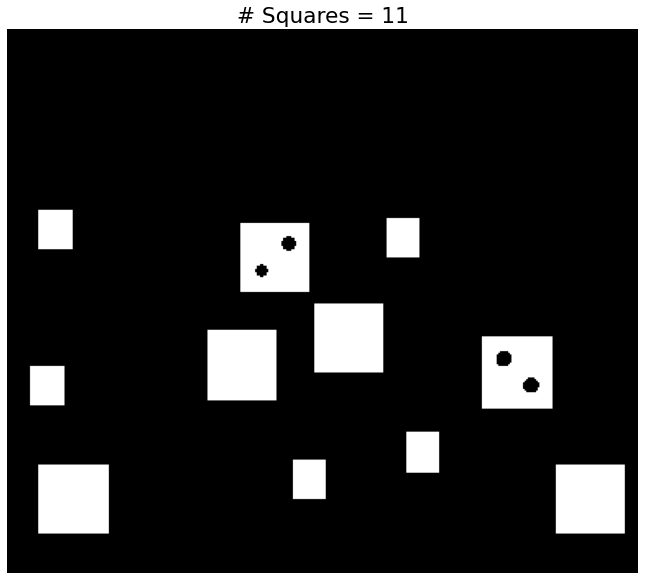

In [145]:
# Apply to above figure.
_, _ = detect_squares(components)

3. Identify the square objects that have holes.

In [152]:
# Identify the square objects that have holes.
def detect_squares_with_holes(components, show = True):
    """Detect square objects that have holes."""
    # First detect holes.
    holed_obj_idx, holed_obj = detect_holes(components, show = False)
    # Close them to remove discrepancies.
    SE = np.ones((9, 9), dtype="uint8"); SE[4, 4] = 2 # Define 5*5 SEs
    closed_obj = [closing(holed_obj[k], SE) for k in holed_obj_idx]
    # construct SE to detect corners. Here we're constructing it manually, also we can pass it as an argument.
    se = np.array([[0,0,-1], [0,2,1], [-1,1,-1]])# 2 specifies origin. Detecting upper left corner
    # Apply SE on Objects above to know how many of them are actually squares.
    squares = np.array([detect_corners(obj, se).sum() for obj in closed_obj])
    # Find the indices of squared objects.
    square_idx = np.argwhere(squares == 1).ravel()
    # show the Plot.
    if show:
        final_structure = filter_components(components, np.array([(holed_obj_idx+1)[idx] for idx in square_idx]))
        plt.figure(figsize = (12, 10))
        plt.imshow(final_structure*255, cmap = "gray")
        plt.title(f"# Squares with Holes = {len(square_idx)}"); plt.axis("off"); plt.show()
    # Return those objects.
    return np.array([(holed_obj_idx+1)[idx] for idx in square_idx]), closed_obj

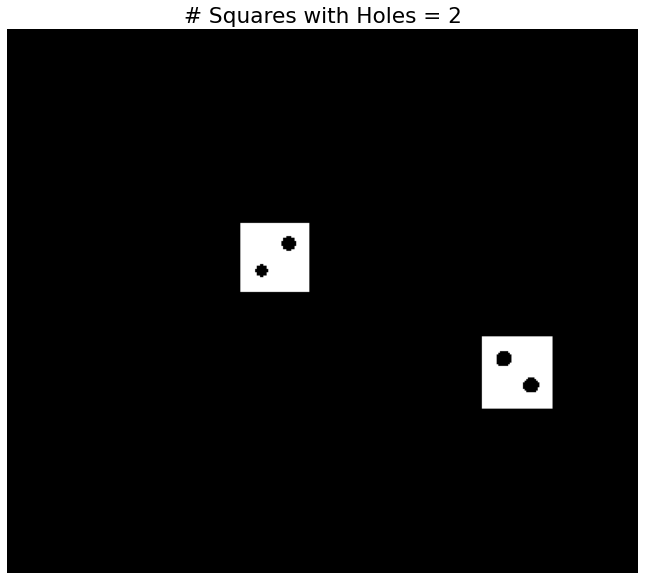

In [153]:
# Apply to above figure.
_, _ = detect_squares_with_holes(components)

4. Identify the circular objects that have no holes

In [156]:
# Identify the circular objects that have no holes
def circles_without_holes(components, show = True):
    """Find circles without holes.
    This function is specific to this question.
    """
    # find squares and their indices and take the complement.
    square_idx, objs = detect_squares(components, show = False)
    # complement indices.
    comp_idx = [k for k in range(int(np.max(components))) if k not in square_idx]
    # Obtain the Circular objects.
    objects = [objs[k] for k in comp_idx]
    # area before closing.
    area_before_closing = np.array([obj.sum() for obj in objects])
    # Apply Closing on Objects.
    box_se = np.ones((5, 5), dtype="uint8"); box_se[2, 2] = 2 # Define 5*5 SEs
    closed_objects = [closing(obj, box_se) for obj in objects]
    # Calculate area after closing.
    area_after_closing = np.array([obj.sum() for obj in closed_objects])
    # Check at which place object has not grown or equal in size.
    indices_for_const_obj = np.argwhere(area_after_closing <= area_before_closing).ravel()
    # show the Plot.
    if show:
        final_structure = filter_components(components,\
                                            np.array([(comp_idx[j]+1) for j in indices_for_const_obj]))
        plt.figure(figsize = (12, 10))
        plt.imshow(final_structure*255, cmap = "gray")
        plt.title(f"# Circles without Holes = {len(indices_for_const_obj)}"); plt.axis("off"); plt.show()
    # Return those objects.
    return indices_for_const_obj, objects

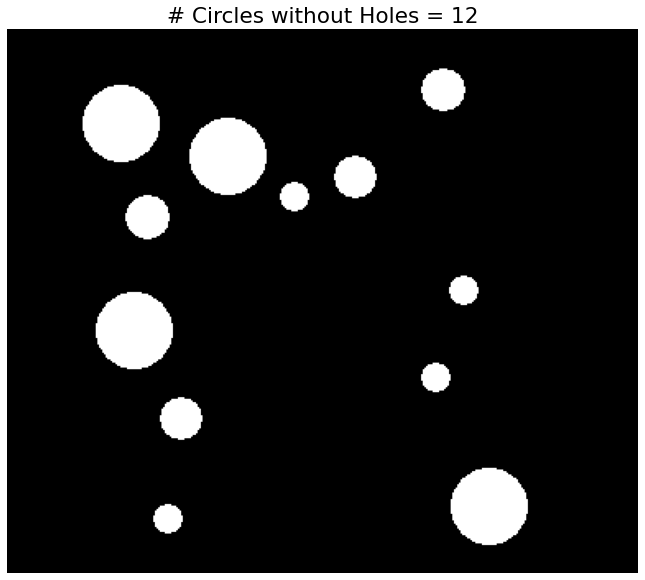

In [157]:
# circles_without_holes
_, _ = circles_without_holes(components)

## Question 2.3 - Morphological Operations

**(20 points)** Read in the binary image `circles.jpg` and write a script which uses the image as input and outputs a new image containing.

1. only the coins touching the boundary of the image
2. only the coins which overlap with each other
3. only non-overlapping coins

The shape of Circles Image = (773, 444)


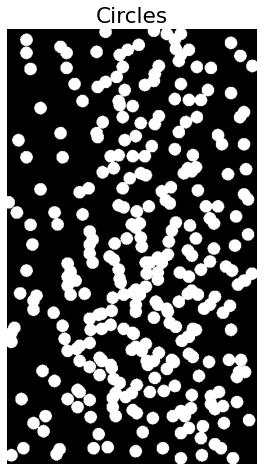

In [158]:
# Import the circles.jpg.
circles = gray(cv2.imread("../images/circles.jpg"))
show_img(circles, "Circles", show_shape = True, shape = (10, 8), lim_enabled = True)
# Apply thresholding.
_, circles_binary = cv2.threshold(circles, 150, 255, cv2.THRESH_BINARY)
circles_binary = (circles_binary/255).astype("uint8")

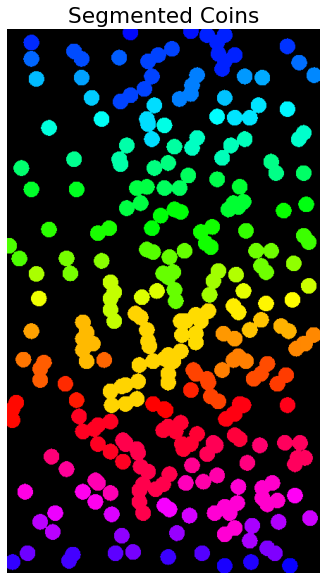

In [160]:
# Extract the components.
_, circle_components = compute_connected_components(circles_binary)
plot_connected_components(circle_components, title = "Segmented Coins")

In [198]:
# only the coins touching the boundary of the image
# IDEA: First filter out individual objects and then for 
# each check if their first row or column or last r or c contains any non-zero.
# If yes then that's it.
def check_boundary_structures(obj):
    """Output boolean if the structure in obj is lying at boundary"""
    # First two are first and last row and last two are first and last column.
    if np.any([np.any(np.vstack([obj[0, :], obj[-1, :]])), np.any(np.vstack([obj[:, 0], obj[:, -1]]))]):
        return True
    return False

def boundary_structures(components, show = True):
    """
    Show objects at the boundary of given binary image.
    """
    # Convert components into individual objects.
    tot_components = np.max(components) # total number of components.
    # Obtain the objects. Filter out each individual components.
    objects = [filter_components(components, idx) for idx in range(1, tot_components+1)]
    # Check for first r or c or last r or c and obtain the requires index.
    # filter(check_boundary_structures, objects) --> filter out objects
    req_objs = np.array(list(filter(check_boundary_structures, objects)))
    # Display.
    if show:
        final_structure = np.sum(req_objs, axis = 0)
        plt.figure(figsize = (12, 10))
        plt.imshow(final_structure*255, cmap = "gray")
        plt.title(f"# Boundary structures = {len(req_objs)}"); plt.axis("off"); plt.show()
    # Return those objects.
    return req_objs

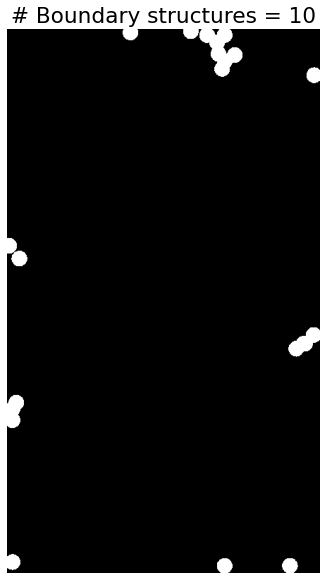

In [197]:
# Show the structures.
_ = boundary_structures(circle_components)

In [200]:
# only the coins which overlap with each other
# IDEA: filter out each individual components. And try to compute area. 
# Area above user set threshold should be regarded as overlapping coin.
def overlapping(components, threshold, want = True, show = True):
    """
    Shows which coins are overlapping and separates them out from the rest.
    """
    # Convert components into individual objects.
    tot_components = np.max(components) # total number of components.
    # Obtain the objects. Filter out each individual components.
    objects = [filter_components(components, idx) for idx in range(1, tot_components+1)]
    # area before closing.
    area = np.array([obj.sum() for obj in objects])
    # Check at which place object has size > Threshold.
    if want: # IF we want overlapping.
        indices_for_obj = np.argwhere(area > threshold).ravel()
    else:
        indices_for_obj = np.argwhere(area <= threshold).ravel()
    # show the Plot.
    if show:
        final_structure = filter_components(components, indices_for_obj + 1)
        plt.figure(figsize = (12, 10))
        plt.imshow(final_structure*255, cmap = "gray")
        if want:
            plt.title(f"# Overlapping structures = {len(indices_for_obj)}")
        else:
            plt.title(f"# Non-Overlapping structures = {len(indices_for_obj)}")
        plt.axis("off"); plt.show()
    # Return those objects.
    return indices_for_obj, objects

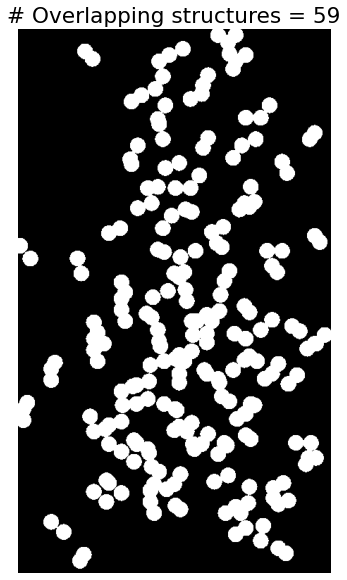

In [176]:
_, _ = overlapping(circle_components, 420)# Just see the array and noted 20 units is diameter=> 314 is least area

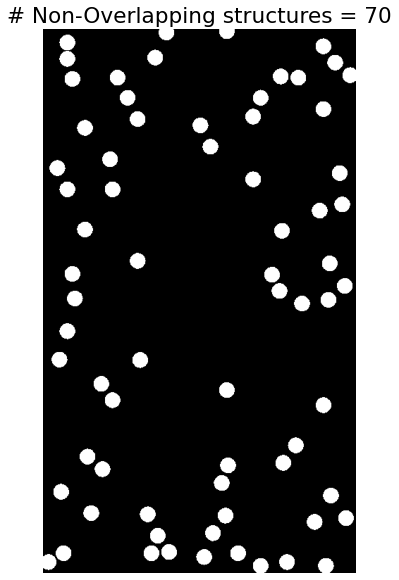

In [201]:
# Show Non-Overlapping circles
_, _ = overlapping(circle_components, 420, want = False)

# Question 3

**(40 points)** Display the segmented image for `coins.jpg` using below mentioned methods and count the number of coins in each method.

## Question 3.1 - Thresholding

1. Show the results on **multiple threshold values**. Use **morphological methods** to fill gaps in the thresholded image and obtain the number of coins without manually counting.

The shape of Coins Image = (303, 384)


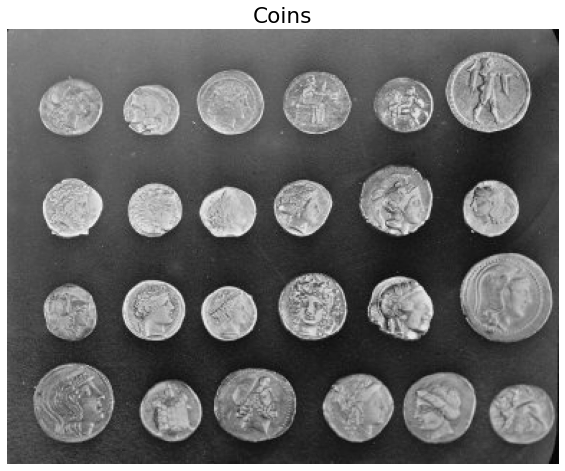

In [6]:
# Import the coin.jpg.
coins = gray(cv2.imread("../images/coins.png"))
show_img(coins, "Coins", show_shape = True, shape = (10, 8), lim_enabled = True)

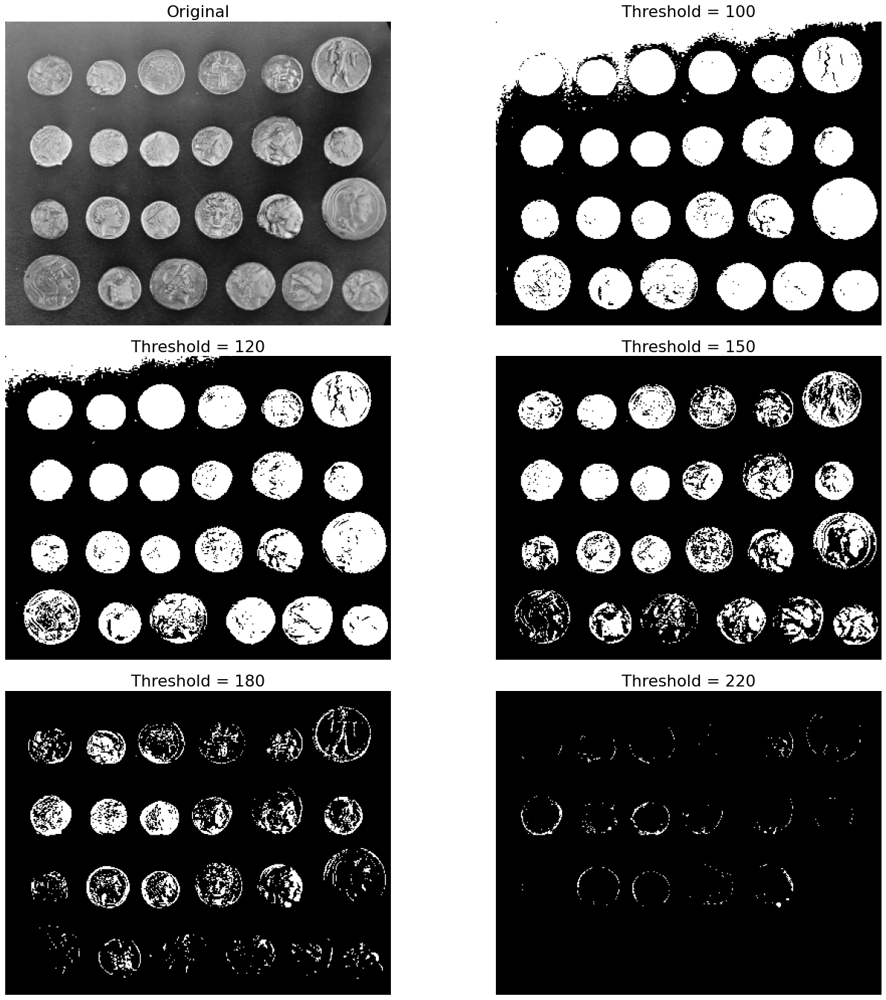

In [206]:
# Apply thresholding.
thresholds = [100, 120, 150, 180, 220]
thresholded = [coins]
for th in thresholds:
    _, coins_binary = cv2.threshold(coins, th, 255, cv2.THRESH_BINARY)
    thresholded.append(coins_binary)
    #coins_binary = (coins_binary/255).astype("uint8")
    
# Show the images.
plotter(3, 2, thresholded, ["Original"]+[f"Threshold = {k}" for k in thresholds], mode='GRAY')

**Seeing above plots, the threshold $= 130$ lying in between $120$ and $150$ is appropriate.**

In [15]:
_, coins_binary = cv2.threshold(coins, 135, 255, cv2.THRESH_BINARY)
coins_binary = (coins_binary/255).astype("uint8")

**Use `closing` to fill the gaps and filter out components to count total no. of coins.**

In [16]:
# Closing.
# Structuring Element --------------------------------
se = np.ones((7, 7)); se[3, 3] = 2
# apply closing.
coins_closed = closing(coins_binary, se)

**Filter out the components and count.**

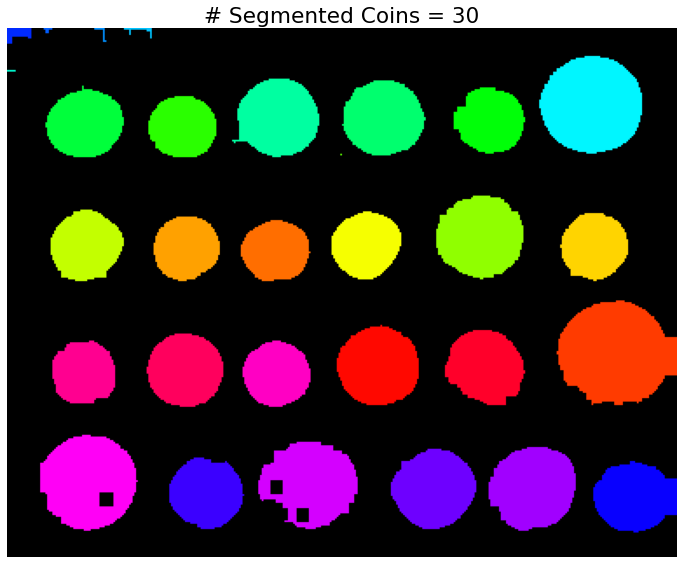

In [17]:
# Extract the components.
counts_coins, coins_components = compute_connected_components(coins_closed)
plot_connected_components(coins_components, title = f"# Segmented Coins = {counts_coins}")

**Let's crop out some intial rows and columns.**

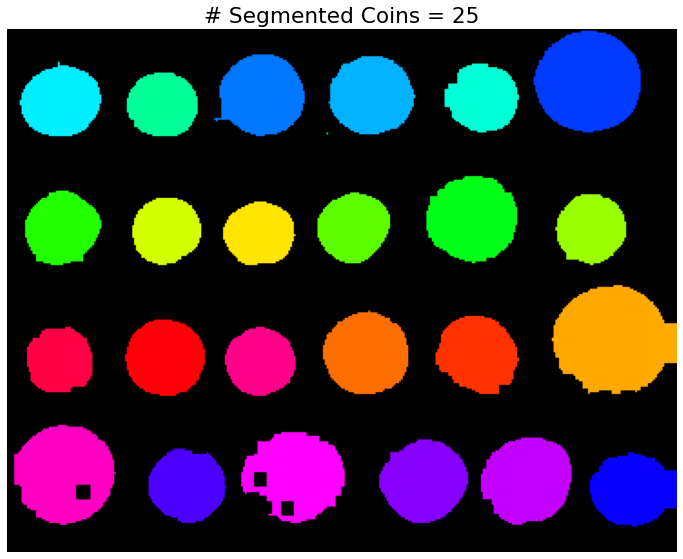

In [18]:
coins_closed_cropped = coins_closed[15:, 15:]
# Extract the components.
counts_cropped, cropped_coins_components = compute_connected_components(coins_closed_cropped)
plot_connected_components(cropped_coins_components, title = f"# Segmented Coins = {counts_cropped}")

**Actually it's `24` but we got close i.e., $= 25$**

2. Implement **`Otsu’s`** thresholding and then perform the counting. Compare your results with `1`.

In [3]:
# Define Otsu's thresholding function.
def otsu(im):
    """
    Return the optimal threshold value for binarizing one-channel image.
    """
    # Will be performing all operations on tmp_im
    tmp_im = np.copy(im)
    # compute histogram.
    # since range=(a.min(), a.max()), then choosing bnis = 255 would suffice. as max range for pixels = 255
    hist, bin_edges = np.histogram(tmp_im.reshape(-1), bins = np.arange(257), density=True)
    # Initialize sigma_b to -inf and optimal_threshold to 128.
    sigma_b = -np.inf; optimal_threshold = 128
    # Average intensity.
    mG = np.sum(hist*bin_edges[:-1])
    for k in range(tmp_im.min(), tmp_im.max()):
        # choose threshold = mean of kth and (k+1)th entry
        th = (bin_edges[k] + bin_edges[k + 1])/2 # due to this k+1 we avoid adding +1 in range.
        # probability of C1 class
        P1 = np.sum(hist[:(k+1)])
        # Probability of C2 class
        P2 = np.sum(hist[k+1:])
        # means of C1 and C2
        m1 = np.sum(hist[:k+1]*bin_edges[:k+1])/P1
        m2 = np.sum(hist[k+1:]*bin_edges[k+1:-1])/P2# to avoid 256 we invoked -1
        # Between Class variance.
        sigma_b_tmp = P1*(m1-mG)**2 + P2*(m2-mG)**2
        #check for optimality.
        if sigma_b_tmp > sigma_b:
            # Swap.
            sigma_b = sigma_b_tmp
            optimal_threshold = th
    return optimal_threshold

In [68]:
# Otsu's Threshold.
otsu_threshold = otsu(coins)
_, coins_binary_otsu = cv2.threshold(coins, otsu_threshold, 255, cv2.THRESH_BINARY)
coins_binary_otsu = (coins_binary_otsu/255).astype("uint8")

**Use `closing` to fill the gaps and filter out components to count total no. of coins.**

In [71]:
# Closing.
# Structuring Element --------------------------------
se = np.ones((7, 7)); se[3, 3] = 2
# apply closing.
coins_closed_otsu = closing(coins_binary_otsu, se)

**Filter out the components and count.**

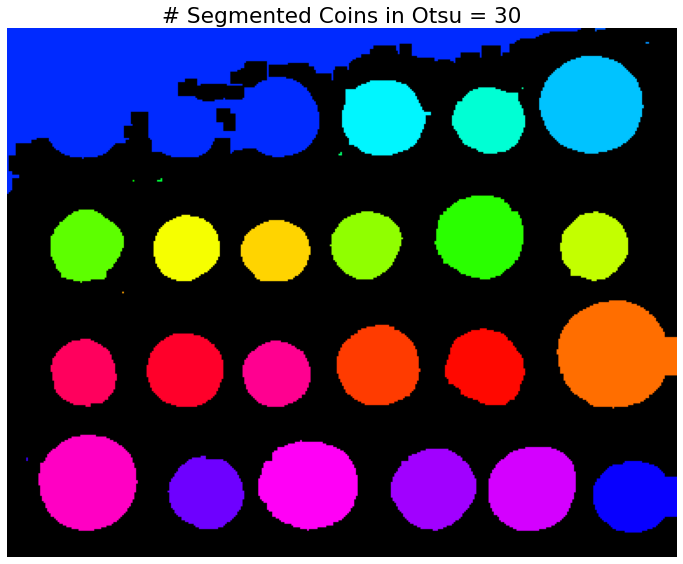

In [72]:
# Extract the components.
counts_coins_otsu, coins_components_otsu = compute_connected_components(coins_closed_otsu)
plot_connected_components(coins_components_otsu, title = f"# Segmented Coins in Otsu = {counts_coins_otsu}")

**Let's crop out some intial rows and columns.**

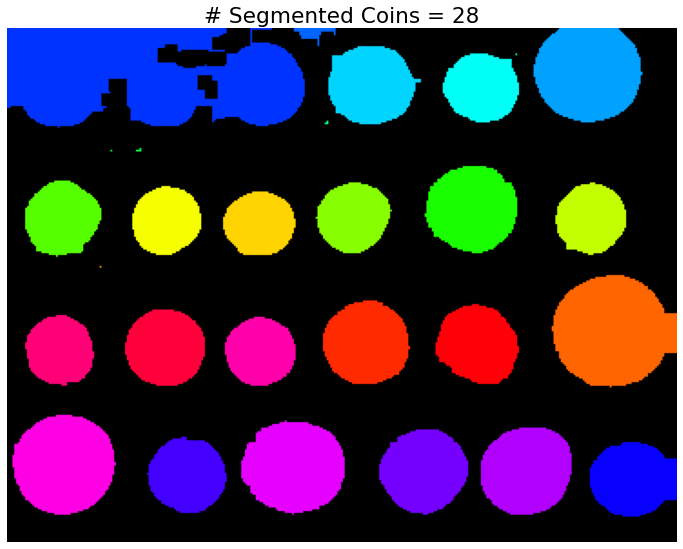

In [73]:
coins_closed_cropped_otsu = coins_closed_otsu[20:, 15:]
# Extract the components.
counts_cropped_otsu, cropped_coins_components_otsu = compute_connected_components(coins_closed_cropped_otsu)
plot_connected_components(cropped_coins_components_otsu, title = f"# Segmented Coins after cropping with Otsu = {counts_cropped_otsu}")

**It's no way better than the previous than our brute-force or hit-and-trial method.**

## Question 3.2 - Edge-based segmentation

Show the results by using different detection methods like `sobel`, `canny`, and `laplacian` to detect the edges and further use `morphological methods` to obtain segmented image.

**Apply `Edge based Filter` $\longrightarrow$ `Otsu's thresholding` and then use `Closing` Morphological processing to obtain segmented images.**

In [9]:
# Structuring Element --------------------------------
se = np.ones((7, 7)); se[3, 3] = 2

# For Sobel.
# Calculation of Sobelx
coins_sobelx = cv2.Sobel(coins, cv2.CV_8UC1, 1, 0, ksize=3)
# Calculation of Sobely
coins_sobely = cv2.Sobel(coins, cv2.CV_8UC1, 0, 1, ksize=3)
sobel_mag = cv2.addWeighted(coins_sobelx, 0.5, coins_sobely, 0.5, 0)
sobel_otsu = otsu(sobel_mag)
_, sobel_binary_otsu = cv2.threshold(sobel_mag, sobel_otsu, 255, cv2.THRESH_BINARY)

# apply closing.
sobel_closed_otsu = closing((sobel_binary_otsu/255).astype("uint8"), se)

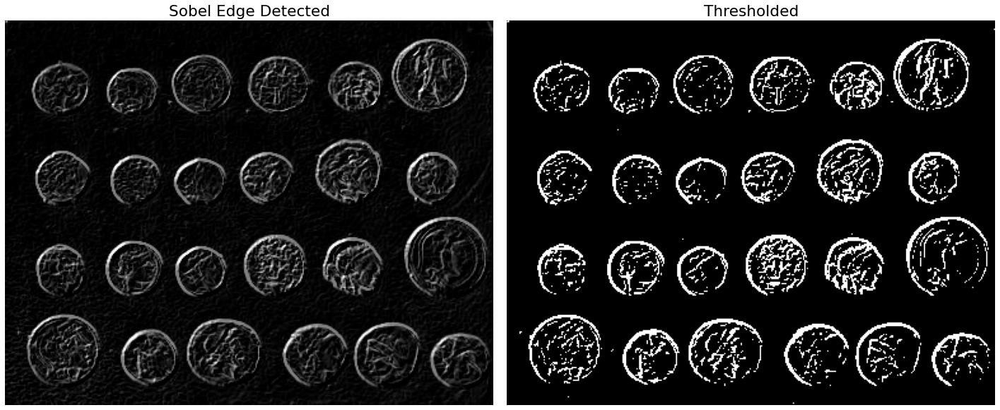

In [11]:
plotter(1, 2, [sobel_mag, sobel_binary_otsu], ["Sobel Edge Detected", "Thresholded"],\
        mode='GRAY', figsize = (20, 20), lim_enabled = False)

In [12]:
# For Laplacian
coins_laplacian = cv2.Laplacian(coins, cv2.CV_8UC1)
laplacian_otsu = otsu(coins_laplacian)
laplacian_binary_otsu = (coins_laplacian >= laplacian_otsu).astype("uint8")*255
#cv2.threshold(coins_laplacian, laplacian_otsu, cv2.THRESH_BINARY)

# apply closing.
laplacian_closed_otsu = closing((laplacian_binary_otsu/255).astype("uint8"), se)

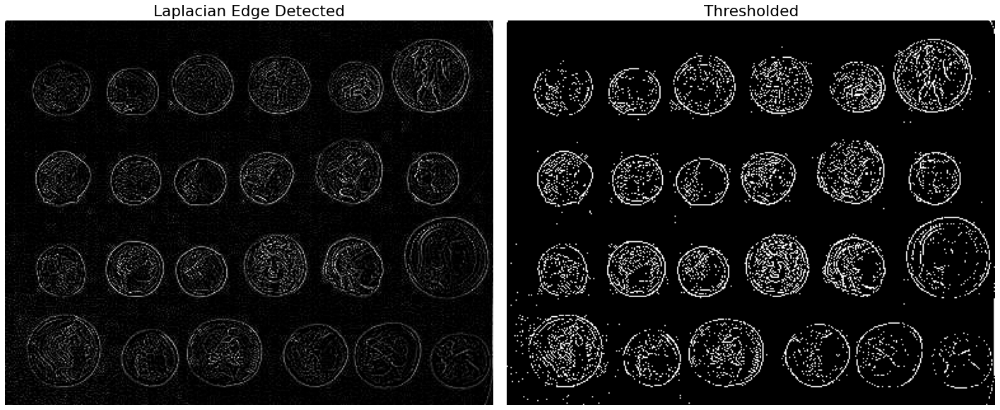

In [13]:
plotter(1, 2, [coins_laplacian, laplacian_binary_otsu], ["Laplacian Edge Detected", "Thresholded"],\
        mode='GRAY', figsize = (20, 20), lim_enabled = False)

In [14]:
# For Canny
coins_canny = cv2.Canny(coins, 90, 140)
canny_otsu = otsu(coins_canny)
canny_binary_otsu = (coins_canny >= canny_otsu).astype("uint8")*255
#cv2.threshold(coins_canny, canny_otsu, cv2.THRESH_BINARY)

# apply closing.
canny_closed_otsu = closing((canny_binary_otsu/255).astype("uint8"), se)

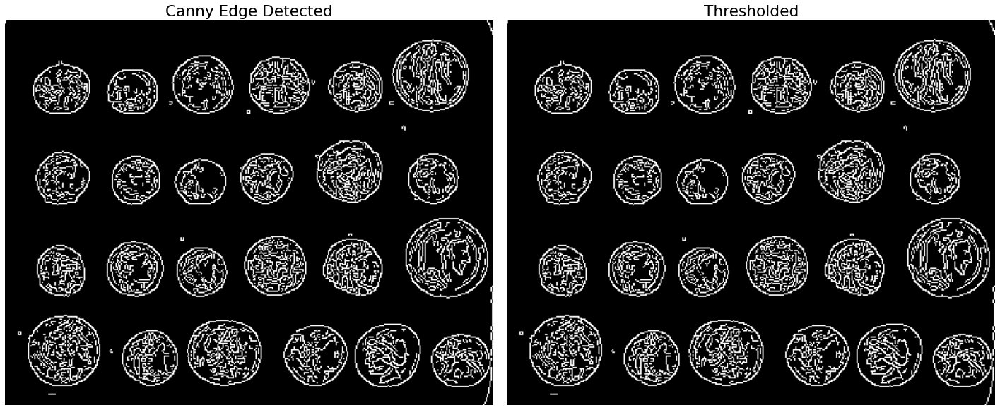

In [15]:
plotter(1, 2, [coins_canny, canny_binary_otsu], ["Canny Edge Detected", "Thresholded"],\
        mode='GRAY', figsize = (20, 20), lim_enabled = False)

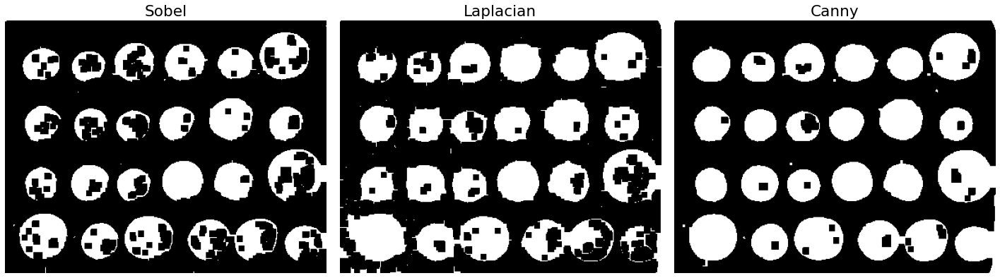

In [135]:
# Plot the segmented Images.
plotter(1, 3, [sobel_closed_otsu, laplacian_closed_otsu, canny_closed_otsu],\
        ["Sobel", "Laplacian", "Canny"], mode='GRAY', figsize = (20, 20), lim_enabled = False)

## Question 3.3 - Comparison and Analysis

Compare and analyse the results obtained from the above segmentation methods.

1. As per the results obtained above, none of them are **ideally perfect**.
2. With `manual thresholding` $\longrightarrow$ `morphological operations` $\longrightarrow$ `component estimation` we got the best segmentation results, whose results are shown above.
3. If the thresholding criteria changes to `Otsu's` thresholding as in above step, the results get worse.
4. And with `edge detection` $\longrightarrow$ `thresholding` $\longrightarrow$ `morphological opening` we got results that are not good as mentioned in step 2, but are comparable to step 3. And among them if we rank, then the following would be the ranking:
    1. `Canny`
    2. `Sobel`
    3. `Laplacian`

# Question 4 - Hough Transform on Road Image

**(40 points)** Consider the image `roads.jpg` and solve the following:
1. Show the outline of **the vertically oriented middle carriageways** which are not connected to the circle like interchanges. Refer figure 2a.

The shape of Roads Image = (1207, 1207, 3)


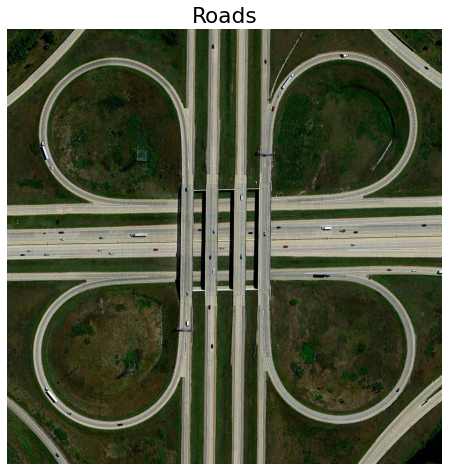

In [34]:
# Import the road Image.
road = cv2.imread("../images/roads.jpg")
show_img(road, "Roads", show_shape = True, shape = (10, 8), lim_enabled = True)

In [5]:
# Turn it to Gray Version...
road_gray = gray(road)

**Methodology:**
1. Detect edges from smoothed gray-scale images.
2. Apply some sort of thresholding to binarize the same.
3. Detect the required (horizontal or vertical) edges applying apt filter.
4. Apply Hough Transform on the binarized edge form image, to obtain the lines.

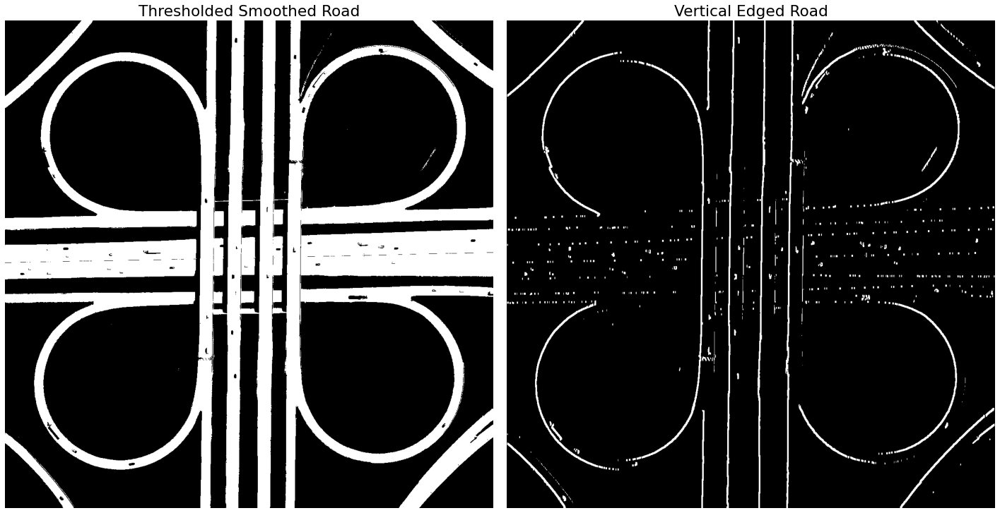

In [6]:
# Apply smoothing with Bilateral Filter.
road_smoothed = cv2.bilateralFilter(road_gray, 15, 75, 75)
# Apply thresholding to binarize.
road_otsu = otsu(road_smoothed)
_, road_binary = cv2.threshold(road_smoothed, road_otsu, 255, cv2.THRESH_BINARY)
# Apply Edge detection Gx filter on the Thresholded Smoothed Road Image to detect vertical edges.
# Calculation of Sobelx
road_sobelx = cv2.Sobel(road_binary, cv2.CV_8UC1, 1, 0, ksize=5)
# Show Images.
plotter(1, 2, [road_binary, road_sobelx], ["Thresholded Smoothed Road", "Vertical Edged Road"], 
        mode='GRAY', figsize = (20, 20), lim_enabled = True)
road_sobelx = (road_sobelx/255).astype("uint8")

**Resources**
1. https://en.wikipedia.org/wiki/Circle_Hough_Transform

2. https://sbme-tutorials.github.io/2018/cv/notes/5_week5.html

3. https://alyssaq.github.io/2014/understanding-hough-transform/

4. https://docs.opencv.org/3.4/d4/d70/tutorial_hough_circle.html

In [11]:
# define Hough Transformation function.

def point_to_line(i, j, A, theta):
    """Changes point in Image space to Line equation in Parameter space."""
    for t in theta:
        # Estimate perpendicular distance to line from origin
        perp = j * np.cos(t*np.pi/180) + i * np.sin(t*np.pi/180)
        # Take nearest integer point for distance and update A.
        A[round(perp), t] += 1
    
def point_to_circle(i, j, A, radii, radius_range):
    """Change a point in Image space to circle equation in parameter space for a given radius."""
    for radius in range(radii):
        # vary the radius from lower limit to upper limit.
        r = radius+radius_range[0]
        for theta in range(0,360):
            #a = i+r; b = j+r
            th = theta*(np.pi/180)
            cos = np.cos(th)
            sin = np.sin(th)
            a = int(j - r*cos)
            b = int(i - r*sin)
            A[a,b,radius] += 1
    
def hough_transform(img, to_find = "lines", theta = None, radius_range = None):
    """
    img: Binary Edged Image
    Output:
        lines for straight features, and circles for circular features.
    """
    m, n = img.shape
    # diagonal.
    diag = int(np.sqrt(m**2 + n**2))
    if to_find == "lines":
        #if rho is None:
            # Discretizing Diagonal length with d_rho = 1 unit.
            #rho = [k for k in range(1, diag + 1)]
        if theta is None:
            # Discretizing 360 deg angle with d_theta = 1 deg.
            theta = [t for t in range(0, 360)]
        # construct Accumulator array.
        A = np.zeros((diag, 360), dtype = np.uint16)
        # for each edge pixels do--->
        for i in range(m):
            for j in range(n):
                if img[i,j] == 1:
                    point_to_line(i, j, A, theta)
        return A
    elif to_find == "circles":
        
        if radius_range is None:
            radius_range = [1, diag//2]# Circle covering the rectangle.
        # Range of radius.
        radii = radius_range[1]-radius_range[0] + 1 # Inclusive range
    
        # As point in extremes also expand, add diameter to both shapes.
        A = np.zeros((m+(2*radius_range[1])+1, n+(2*radius_range[1])+1, radii), dtype = np.uint16)

        # for each edge pixels do--->
        for i in range(m):
            for j in range(n):
                if img[i,j] == 1:
                    point_to_circle(i, j, A, radii, radius_range)

        return A
    else:
        raise ValueError("Sorry! We can just find Lines and Circle objects.")

In [10]:
# LEt's compute the straight lines.
theta = [(t%360) for t in range(350, 371)]
A = hough_transform(road_sobelx, theta = theta)

**Since we need to detect $4$ lines, we took some considerable amount of maximum entries of `A` and their corresponding indices to figure out the parameters.**

In [107]:
# 17 is from hit and trial.

# Filter out max entries.
max_entries = np.sort(A.flatten("F"))[:-17:-1]
# Their corresponding indices.
perp_dist = [np.argwhere(A == val)[0][0] for val in max_entries]
ang_deg = [np.argwhere(A == val)[0][1] for val in max_entries]

In [9]:
# function to obtain co-ordinates of line.
def coord(img, ang_deg, perp_dist):
    """points to draw line."""
    if ang_deg == 0:# to prevent divide by zero.
        ang_deg = 360
    m, n = img.shape
    x_range = np.array([0, n-1]); y_range = np.array([0, m-1])
    # For all possible angle and perp_dist.
    y_val = (-x_range/(np.tan(ang_deg*np.pi/180)) + (perp_dist/np.sin(ang_deg*np.pi/180))).astype(int)
    x_val = (-y_range*(np.tan(ang_deg*np.pi/180)) + (perp_dist/np.cos(ang_deg*np.pi/180))).astype(int)
    #if 0 <= y_val < y_range[1]:
    val_points = []
    for k in range(len(y_val)):
        if 0 <= y_val[k] < y_range[1]:
            val_points.append([x_range[k], y_val[k]])
    for l in range(len(x_val)):
        if 0 <= x_val[l] < x_range[1]:
            val_points.append([x_val[l], y_range[l]])
    return np.array(val_points)

In [105]:
image1 = np.copy(road_sobelx*255)
# draw all the lines on the image.
for p, t in zip(perp_dist, ang_deg):
    coords = coord(img, t, p)
    # Start coordinate
    start_point = coords[0]

    # End coordinate
    end_point = coords[1]

    # White color in BGR
    color = (255, 255, 255)

    # Line thickness
    thickness = 12

    # Using cv2.line() method
    # Draw a diagonal green line with thickness of 9 px
    image1 = cv2.line(image1, start_point, end_point, color, thickness)

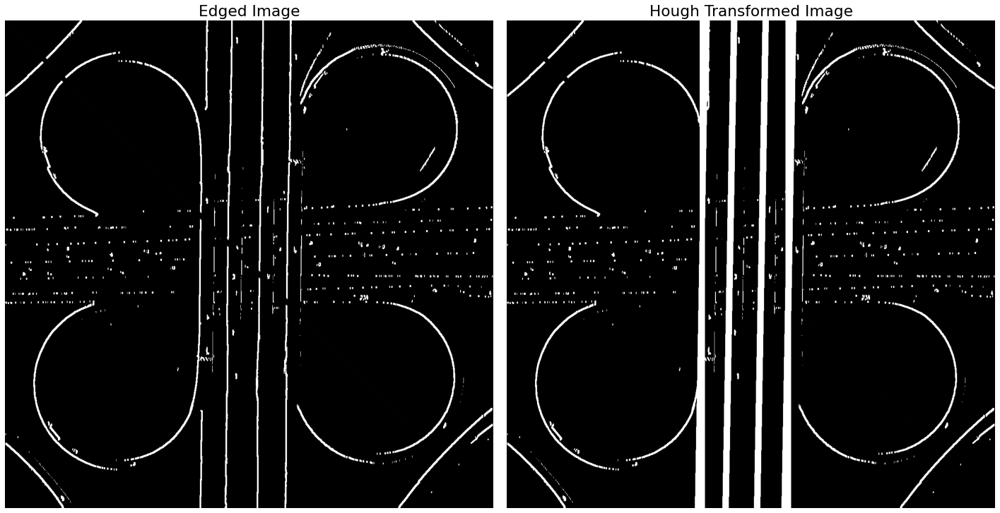

In [106]:
plotter(1, 2, [road_sobelx*255, image1], ["Edged Image", "Hough Transformed Image"], mode='GRAY')

2. Display the **best fitting circle for each of the circle-like interchanges** and __output the radius__ of each in pixels.

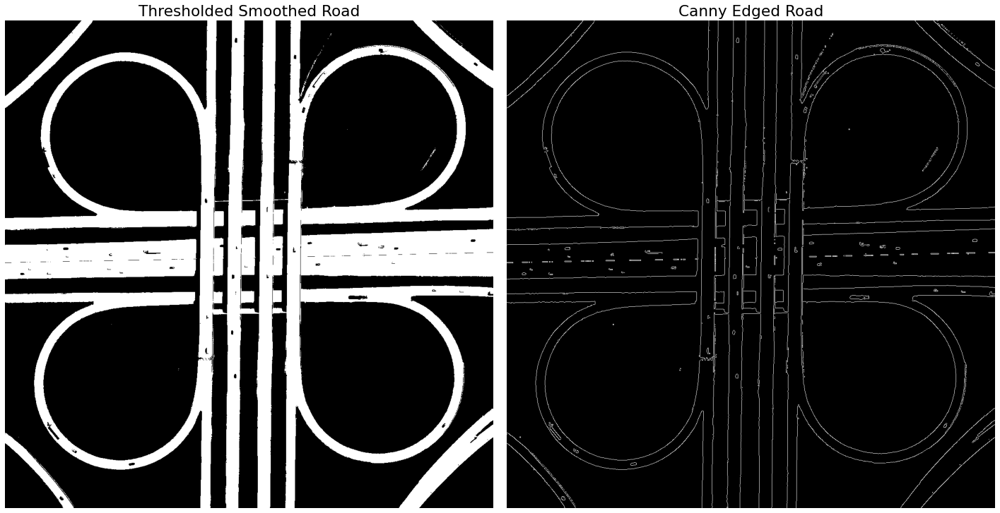

In [9]:
# Perform canny edge detection and then binarize image to get circles.
road_canny = cv2.Canny(road_binary,140, 200)
# Show Images.
plotter(1, 2, [road_binary, road_canny], ["Thresholded Smoothed Road", "Canny Edged Road"], mode='GRAY')
road_canny = (road_canny/255).astype("uint8")
tmp_img = np.copy(road_canny)
tmp_img[475:730, :] = 0
tmp_img[:, 475:730] = 0

In [12]:
# LEt's compute the Circles.
radius_range = [185, 195]
A_canny = hough_transform(tmp_img, to_find = "circles", radius_range = radius_range)

In [13]:
def store_coords(entries, A_canny):
    """Store Centre Coords and Radius"""
    arr = []
    for val in entries:
        arr.append(np.argwhere(A_canny == val))
    coords = np.vstack(arr)
    return coords[:, 0], coords[:, 1], coords[:, 2]

In [21]:
# Filter out max entries.
max_entries_canny = np.sort(A_canny.flatten("F"))[:-25:-1]

a, b, radii = store_coords(max_entries_canny, A_canny)

In [22]:
image2 = np.copy(road_canny*255)
# Draw circles.
for r, ca, cb in zip(radii, a, b):
    # Center coordinates
    center_coordinates = (ca, cb)

    # Radius of circle
    radius = r + radius_range[0]

    # Blue color in BGR
    color = (255, 255, 255)

    # Line thickness of 2 px
    thickness = 12

    # Using cv2.circle() method
    # Draw a circle with blue line borders of thickness of 2 px
    image2 = cv2.circle(image2, center_coordinates, radius, color, thickness)

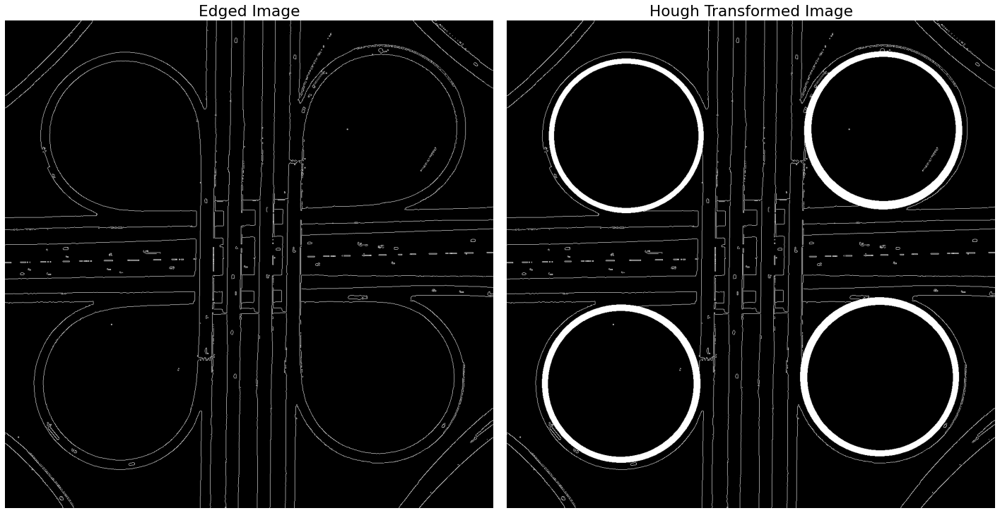

In [23]:
plotter(1, 2, [road_canny*255, image2], ["Edged Image", "Hough Transformed Image"], mode='GRAY')

3. Segment all the __large trailer trucks visible__ in the picture. (Hint : Select the seeds in side the trucks, use region growing to segment those trucks)

In [58]:
trucks_highway = np.copy(road_gray)
i = 180

#thresholding
trucks_highway[trucks_highway>i] = 255
trucks_highway[trucks_highway<=i] = 0

# removing noisy parts
trucks_highway[575:700,:] = 0
trucks_highway[:,480:720] = 0

# morphological operations
trucks_highway = cv2.morphologyEx(trucks_highway, cv2.MORPH_OPEN, cv2.getStructuringElement(cv2.MORPH_RECT,(2,2)))
trucks_highway = cv2.morphologyEx(trucks_highway, cv2.MORPH_ERODE, cv2.getStructuringElement(cv2.MORPH_RECT,(2,2)))
trucks_highway = cv2.morphologyEx(trucks_highway, cv2.MORPH_OPEN, cv2.getStructuringElement(cv2.MORPH_RECT,(3,3)))
trucks_highway = cv2.morphologyEx(trucks_highway, cv2.MORPH_DILATE, cv2.getStructuringElement(cv2.MORPH_RECT,(10,10)))
trucks_highway = cv2.morphologyEx(trucks_highway, cv2.MORPH_CLOSE, cv2.getStructuringElement(cv2.MORPH_RECT,(20,20)))
#trucks_highway1 = cv2.morphologyEx(trucks_highway, cv2.MORPH_ERODE, cv2.getStructuringElement(cv2.MORPH_RECT,(9,9)))

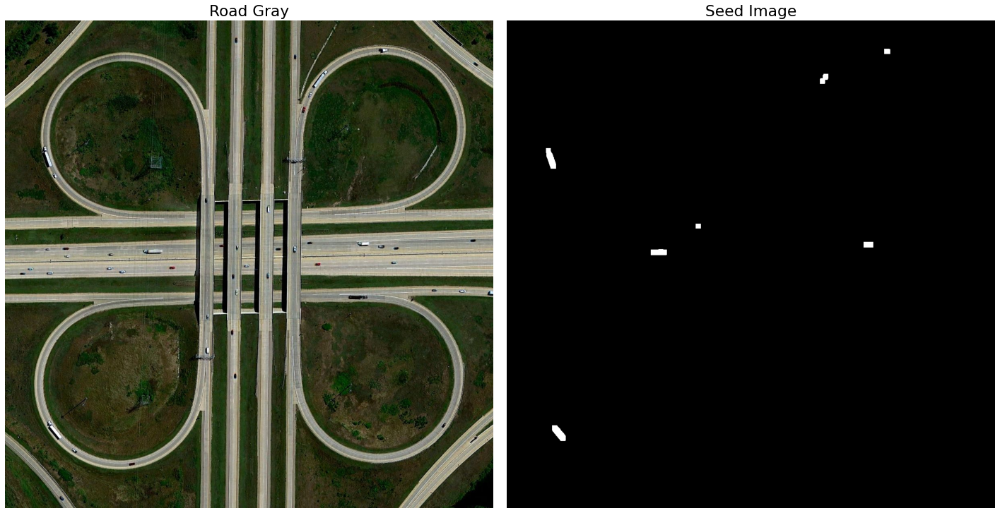

In [59]:
plotter(1, 2, [road, trucks_highway], ["Road Gray", "Seed Image"], mode='RGB',
        figsize = (20, 20), lim_enabled = True)

In [60]:
trucks_binary = (trucks_highway/255).astype("uint8")
# Applying Flood Fill ---> same as growing over to FG with some seed--> same as Region Growing Concept.
_, truck_comp = compute_connected_components(trucks_binary, connectivity = 8,\
                                                             mode = "recursive", label = 0)
# Since we want to show the Truck IN Colour Format, we knowingly chose 3channel image with Gray scale in all channel.
truck_regions = np.zeros(road.shape, dtype = np.uint8)
for i in range(3):
    truck_regions[:,:,i] = np.copy(road_gray)
# Here we perform Coloring...
for i in range(truck_regions.shape[0]):
    for j in range(truck_regions.shape[1]):
        if truck_comp[i,j]>0:
            truck_regions[i,j,:] = [0,255,255]

**`Yellow` colored blocks are the trucks in this image.**

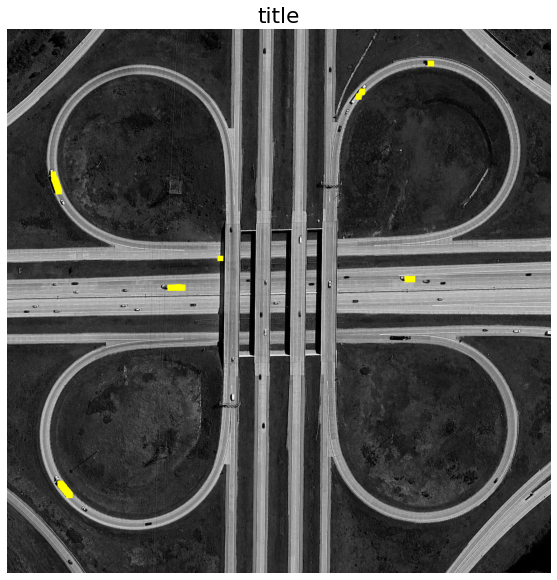

In [61]:
show_img(truck_regions, "title", show_shape = False, shape = (12, 10), lim_enabled = True)

# Question 5 - Sinchan Deblurring

**(50 points)** Given the image `shinchan_blur.png` that is deliberately blurred using a **Gaussian point spread function** of width $ = \sigma$.

1. Write a program that creates an array, of the same size as the photo, sampled from Gaussian point spread function (psf) $f(x,y)$ with $=\sigma$ of your own choice. Display this array, remember that the point spread function is periodic (along both axes), which means that the values for negative $x$ and $y$ are repeated at the end of the interval. Since the Gaussian is centered on the origin, this means there should be bright patches in each of the four corners of your picture.

The shape of Shinchan Blur Image = (1000, 750)


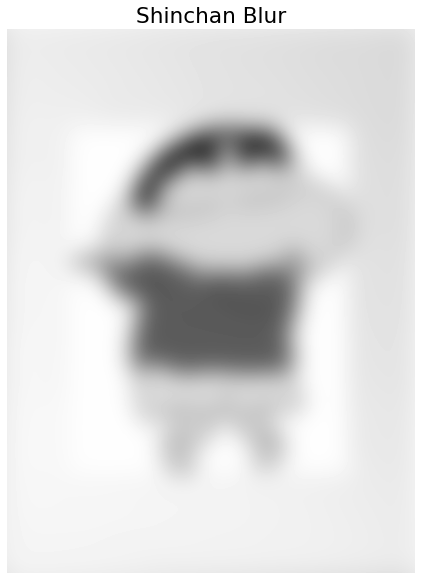

In [18]:
# Read the image = shinchan_blur.png
shinchan_blur = gray(cv2.imread("../images/shinchan_blur.png"))
show_img(shinchan_blur, "Shinchan Blur", show_shape = True, shape = (12, 10), lim_enabled = True)

In [19]:
# Define a function that samples gaussian values, given sigma and shape.
def gauss2DPSF(shape=(3,3), sigma = 1):
    """
    construct gaussian filter of given "shape" and "sigma" with given "method".
    if method == "optimized":
        automatically choose the optimal gaussian filter coefficients.
    else:
        go by "normal" strategy, for that put method = None
        
    Output:
        A Gaussian filter.
    """
    # Sample the values from Gaussian Domain.
    m,n = [(ss-1)/2 for ss in shape]
    y_samples, x_samples = np.ogrid[-m:m+1,-n:n+1]
    # Take the exponential i.e., to gaussian coefficients.
    h = np.exp(-(x_samples**2 + y_samples**2) / (2.*sigma**2))/(2.*np.pi*sigma**2)
    # Setting some limits.
    h[ h < np.finfo(h.dtype).eps*h.max() ] = 0
    # Normalize the matrix by dividing by its sum of elements.
    sumh = h.sum()
    if sumh != 0:
        h /= sumh
    return h

In [20]:
# resize the Sinchan Blur Image to some power of 2. As it will be used during Fourier Transform.
shinchan_blur = cv2.resize(shinchan_blur, (512, 512))

2. Deconvolute the blurred image with *psf* calculated above. (Hint : To get the blurred image, we convolute the focused image with the *psf* to blurred image. Use fourier transform to deconvolute.)
    1. Calculate the Fourier Transforms of Blurred image and *psf*.
    2. Divide Fourier Transform of Blurred image with the Fourier Transform of *psf*.
    3. Perform Inverse fourier transform.

**Include all the Essential Functions.**

In [21]:
# Shift Function used to Centre Shift the FT of Image.
def shift_dft(f):
    """FFT Shift the fourier Transformed Image."""
    n = f.shape[0]
    y = np.asarray(f)  # copy
    # To see its action see rough section.
    y = np.roll(f, n//2, axis=[0,1])
    return y

# define recursive One-Dimensional FFT.
def rec_fft(n, x):
    """Recursively compute FFT (basically a DFT of order n*log(n)); Note that 'n' should be POWER of 2."""
    # Convert the input to numpy array and  Convert it to one dimensional array.
    x = np.asarray(x, dtype=complex).ravel()
    # base condition...
    if n == 1:
        return x[0]
    else:
        # even component...taking even index elements.
        f_even = rec_fft(n//2, x[0::2])
        # odd component...taking odd index elements.
        f_odd = rec_fft(n//2, x[1::2])
        # combine DFTs of two halves into full DFT:
        terms = np.exp((-2j * np.pi * np.arange(n)) / n)
        return np.concatenate([f_even + terms[:(n//2)] * f_odd, f_even + terms[(n//2):] * f_odd])

# Iterative version of One Dimensional FFT.
def iter_fft(x):
    """Vectorized & iterative FFT (basically a DFT of order n*log(n)); Note that 'n' should be POWER of 2."""
    # Convert the input to numpy array and  Convert it to one dimensional array.
    x = np.asarray(x, dtype=complex)
    N = len(x)
    temp = x.reshape((1, N))
    # Run through loop...
    while temp.shape[0] < N:
        m, n = temp.shape
        odd, even = temp[:, n // 2:], temp[:, :n // 2]
        coff = np.exp(-1j * np.pi * np.arange(m) / m)[:, None]
        temp = np.vstack((even + coff * odd, even - coff * odd))

    return temp.ravel()

# Apply Recursive or Iterative FFT to 2D data...
def get_2d(data, mode = "recursive"):
    """Apply `fft` to each row, then to each column."""
    result = np.copy(data)
    if mode == "recursive":
        result = np.array([rec_fft(len(row), row) for row in result])
        result = np.array([rec_fft(len(col), col) for col in result.T])
        return result.T
    elif mode == "iterative":
        result = np.array([iter_fft(row) for row in result])
        result = np.array([iter_fft(col) for col in result.T])
        return result.T
    else:
        raise ValueError("Oops! Wrong Mode. please check your mode parameter.")
    
# Inverse Fourier Transform
def get_ifft(data):
    """Using DUALITY of FOURIER Transform to convert the Frequency domain data to Spatial."""
    # take conjugate of the data...
    Fstar = np.conj(data)
    # Here duality of FT is peformed
    fstar = get_2d(Fstar)
    # Normalizing.
    fstar = fstar / np.product(data.shape)
    return np.conj(fstar)

In [80]:
# Display an array, of the same size as the photo from gaussian PSF.
sigma = min(shinchan_blur.shape)//6
gaussPSF = gauss2DPSF(shape = shinchan_blur.shape, sigma = sigma)

The shape of PSF Image = (512, 512)


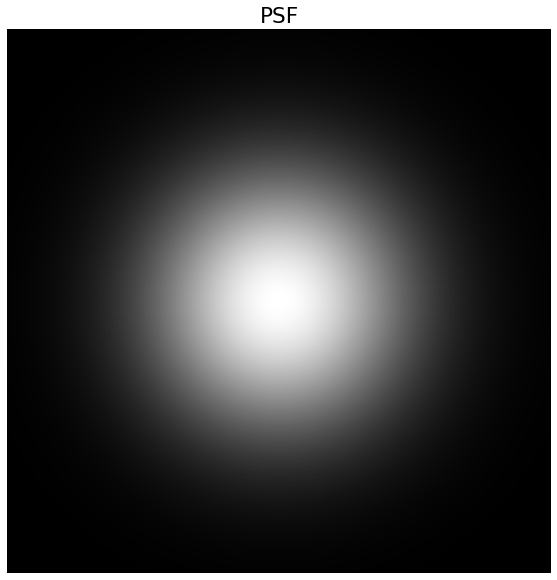

In [23]:
# Display the PSF.
show_img(gaussPSF, "PSF", show_shape = True, shape = (12, 10), lim_enabled = False)

In [69]:
# Multiplying -1 and +1 alternatively to padded image will do the CENTRE Shifting beforehand.
fft_shinchan = get_2d(shinchan_blur, mode = "recursive")
#fft_shinchan_shifted = shift_dft(fft_shinchan)
gaussPSF_fft = get_2d(gaussPSF, mode = "recursive")
#gaussPSF_fft_shifted = shift_dft(gaussPSF_fft)
# Perform element-wise multiplication...
result = fft_shinchan/gaussPSF

# Compute Inverse Fourier Transform.
ifft_im = np.abs(get_ifft(result))
# take the real component and do reverse centre-shifting
#ifft_im = (ifft_im.real)*neg_pos_one_arr(ifft_im)

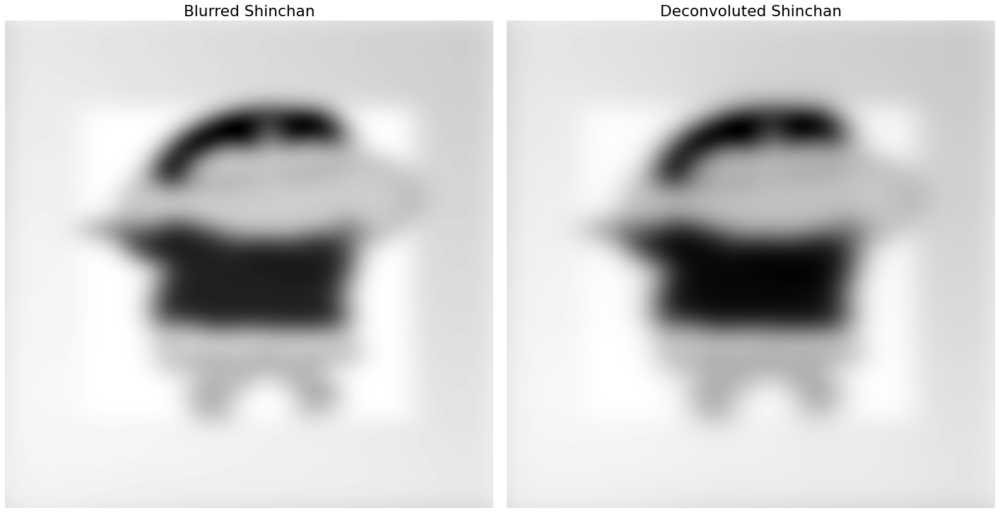

In [71]:
# Show the Image we got from above Deconvolution.
plotter(1, 2, [shinchan_blur, ifft_im], ["Blurred Shinchan", "Deconvoluted Shinchan"], 
        mode='GRAY', figsize = (20, 20), lim_enabled = False)

3. Try the deconvolution of blurred image with psf for various values of $\sigma$.

In [83]:
# Sigma list.
sigmas_lst = [sigma + k for k in np.arange(100, 301, 50)]
sinchan_imgs = [shinchan_blur]
for sig in sigmas_lst:
    gaussPSF_sig = gauss2DPSF(shape = shinchan_blur.shape, sigma = sig)
    # Multiplying -1 and +1 alternatively to padded image will do the CENTRE Shifting beforehand.
    fft_shinchan = get_2d(shinchan_blur, mode = "recursive")
    #fft_shinchan_shifted = shift_dft(fft_shinchan)
    gaussPSF_fft = get_2d(gaussPSF_sig, mode = "recursive")
    # Perform element-wise division...
    result = fft_shinchan/gaussPSF_sig

    # Compute Inverse Fourier Transform.
    sinchan_imgs.append(np.abs(get_ifft(result)))
    

4. Display the your results for the $\sigma$ that deblurred the best.

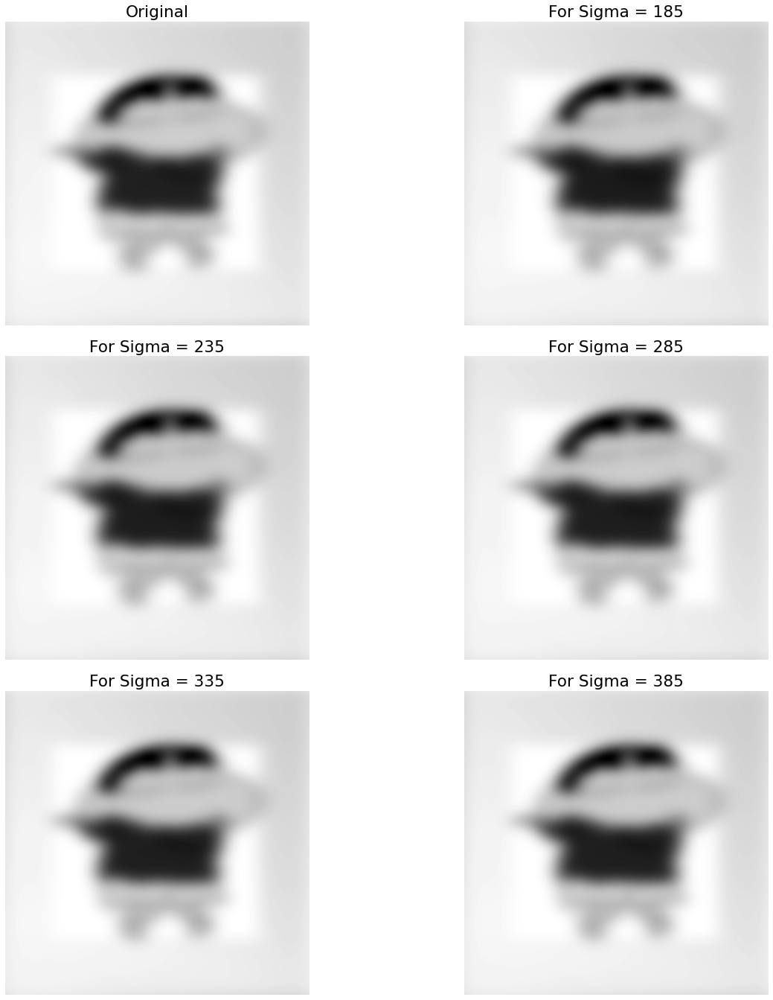

In [85]:
# Plot all.
titles = [f"For Sigma = {k}" for k in sigmas_lst]
plotter(3, 2, sinchan_imgs, ["Original"]+titles, mode='GRAY', lim_enabled = False)

# Question 6 - Image Compression using `Huffman` Coding

**(40 points)** *Kalyan*, who only uses discord wants to share the image `shinchan.pkl`, stored as a string, which is of size `15.4 MB` to his friend. Discord only supports files of size less than `10 MB`.

1. Help Kalyan to compress the color image using `Huffman encoding` to share the image to his friend. You can learn about huffman encoding [here](https://en.wikipedia.org/wiki/Huffman_coding).

The shape of Sinchan - The Sigma Boy Image = (8430, 15000, 3)


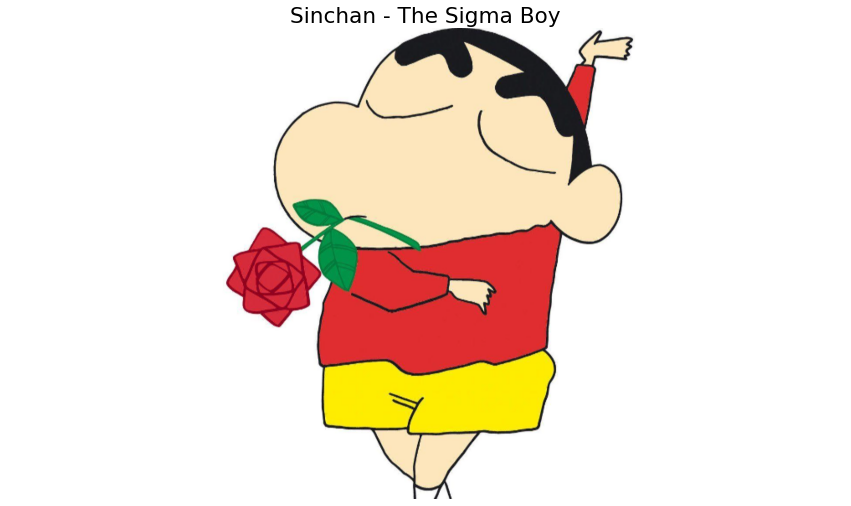

In [64]:
# Read the Sinchan Image.
sin = cv2.imread("../images/shinchan.png")
show_img(sin, "Sinchan - The Sigma Boy", show_shape = True, shape = (15, 13), lim_enabled = True)

In [70]:
# Load Pickle file.
with open("../images/shinchan.pkl", 'rb') as f:
    str_image = pkl.load(f)

2. Display the image stored in the file `shinchan.pkl`.

Sinchan from Pickle Image shape: (648, 1152, 4)


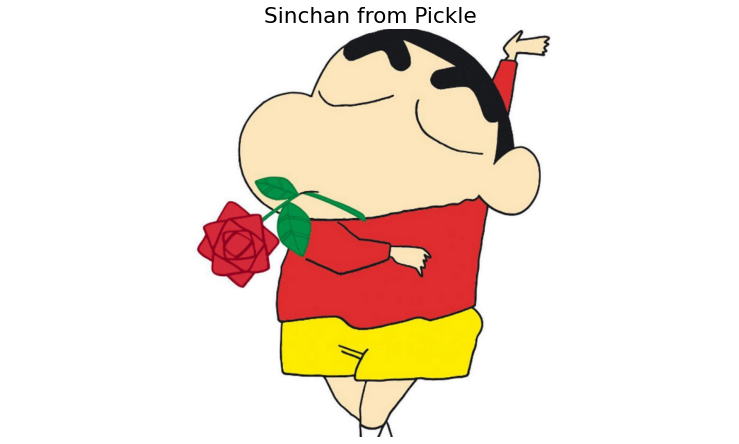

In [73]:
def construct_image_from_string(image_string):
    str_cols = image_string.split("]], ")
    str_rows = list()
    for col in str_cols:
        col = col.strip()
        row = col.split("], ")
        str_rows.append(row)
    rows = list()
    for row in str_rows:
        pixels = list()
        for pixel in row:
            pixel = pixel.strip("[")
            pixel = pixel.strip("]")
            pixel = pixel.split(',')
            pixel = [int(i) for i in pixel]
            pixels.append(np.array(pixel))
        rows.append(np.array(pixels))
    image = np.array(rows)
    return image

sin_img = construct_image_from_string(str_image)
print("Sinchan from Pickle Image shape: {}".format(sin_img.shape))
plt.figure(figsize = (13, 11))
plt.imshow(sin_img); plt.axis("off"); plt.title("Sinchan from Pickle"); plt.show()

A. Create the dictionary of of all the letters in the image array.

In [76]:
def get_pixel_freq(image):
    freq = dict()
    for rows in image:
        for pixel in rows:
            st_pixel = str(list(pixel))
            if st_pixel in freq.keys():
                freq[st_pixel] += 1
            else:
                freq[st_pixel] = 1
    return freq

freq = get_pixel_freq(sin_img)
total_symbols = len(freq)
print("Total symbols: {}".format(total_symbols))


Total symbols: 40885


B. Generate the `Huffman Tree` from the tree generated by considering all the letters in the dictionary as the leaf nodes. Print the Huffman tree.\
C. Assign the code words 0 and 1 to the nodes of the Huffman tree.

In [77]:
class node:
    def __init__(self, freq, symbol, left=None, right=None):
        self.freq = freq
        self.symbol = symbol
        self.left = left
        self.right = right
        self.huff = ''

nodes = list()
for key, val in freq.items():
    nodes.append(node(val, key))

count = 0
while len(nodes) > 1:
    nodes = sorted(nodes, key=lambda x: x.freq)
    left = nodes[0]
    right = nodes[1]
    left.huff = 0
    right.huff = 1
    newNode = node(left.freq+right.freq, left.symbol+right.symbol, left, right)
    nodes.remove(left)
    nodes.remove(right)
    nodes.append(newNode)


huffman_encoding_map = dict()
huffman_decoding_map = dict()

def getHuffmanMapping(node, val=''):
    newVal = val + str(node.huff)
    if(node.left):
        getHuffmanMapping(node.left, newVal)
    if(node.right):
        getHuffmanMapping(node.right, newVal)
    if(not node.left and not node.right):
        huffman_encoding_map[node.symbol] = newVal
        huffman_decoding_map[newVal] = node.symbol

getHuffmanMapping(nodes[0])

print("Total symbols in huffman encoding: {}".format(len(huffman_encoding_map)))
print("The huffman encoding- ")
print(huffman_encoding_map)


Total symbols in huffman encoding: 40885
The huffman encoding- 
{'[25, 25, 27, 255]': '00000000000000', '[248, 229, 193, 255]': '00000000000001', '[248, 229, 192, 255]': '00000000000010', '[253, 226, 191, 255]': '00000000000011', '[253, 226, 192, 255]': '00000000000100', '[222, 44, 49, 255]': '00000000000101', '[225, 42, 49, 255]': '00000000000110', '[220, 46, 46, 255]': '00000000000111', '[252, 250, 251, 255]': '00000000001000', '[227, 41, 47, 255]': '00000000001001', '[214, 48, 46, 255]': '00000000001010', '[252, 250, 252, 255]': '00000000001011', '[224, 42, 49, 255]': '00000000001100', '[3, 143, 72, 255]': '00000000001101', '[212, 41, 60, 255]': '00000000001110', '[214, 43, 58, 255]': '00000000001111', '[219, 45, 49, 255]': '00000000010000', '[210, 42, 61, 255]': '00000000010001', '[213, 41, 56, 255]': '00000000010010', '[249, 238, 0, 255]': '00000000010011', '[248, 238, 0, 255]': '00000000010100', '[253, 234, 5, 255]': '00000000010101', '[255, 233, 1, 255]': '00000000010110', '[254

D. Generate binary code of the image by the binary representation from the above tree.

In [79]:
def encode_image(image, huff_map):
    st_image = "["
    for cols in image:
        st_row = "["
        for row in cols:
            pixel = str(list(row))
            pixel = huff_map[pixel]
            pixel += ", "
            st_row += pixel
        st_image += st_row[:-2] + "], "
    st_image = st_image[:-2] + "]"
    return st_image

encoded_image = encode_image(sin_img, huffman_encoding_map)
print(len(encoded_image))
print(encoded_image[:500])


4184158
[[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 


3. Save the generated binary code of image in `compressed.bin`. This is supposed to be less than `10MB` in size. He will be sharing this file to his friend.

In [85]:
# Convert the encoding into bytes.
encoded_img_bytes = bytes(encoded_image, 'utf-8')

#Save the encodings into compressed.bin file.
with open("../images/compressed.bin", "wb") as fp:
    fp.write(encoded_img_bytes)

4. Print the size of extracted text from `shinchan.pkl` and size of `compressed.bin` in MB.

In [91]:
pkl_size = os.path.getsize('../images/shinchan.pkl')
bin_size = os.path.getsize('../images/compressed.bin')
print("The size of Sinchan.pkl is: {0:.3f} MB while the size of compressed.bin is: {1:.3f} MB\nSuccessfully Compressed!\nKalyan please send it :)".format(pkl_size/1e+6, bin_size/1e+6))

The size of Sinchan.pkl is: 16.161 MB while the size of compressed.bin is: 4.184 MB
Successfully Compressed!
Kalyan please send it :)


5. Write a function to help his friend decode the original image from `compressed.bin` and display it.

In [94]:
# read the encodings from compressed.bin file.
with open("../images/compressed.bin", "rb") as fu:
    img_encoding = fu.read()
# Decode the bytes into string.
img_encoding = img_encoding.decode("utf-8")

Sinchan after Decoding: (648, 1152, 4)


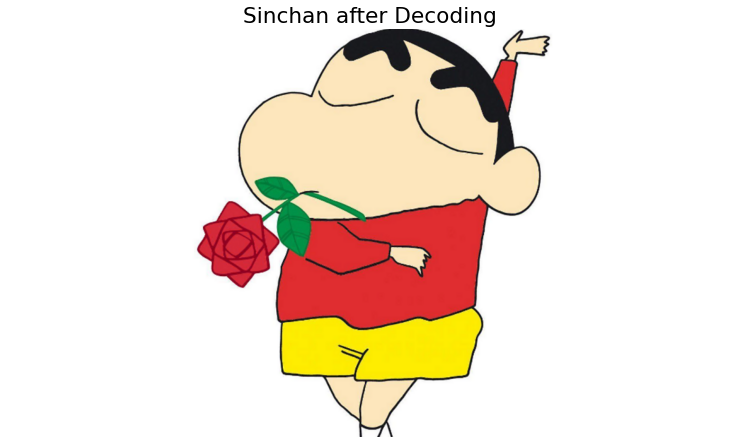

In [99]:
def decode_image_str(encoded_image, huff_map):
    str_cols = encoded_image.split("], ")
    cols = "["
    for col in str_cols:
        col = col.strip("[")
        col = col.strip("]")
        str_rows = col.split(",")
        rows = "["
        for row in str_rows:
            row = row.strip()
            row = huff_map[row]
            row += ", "
            rows += row
        cols += rows[:-2] + "], "
    cols = cols[:-2] + "]"
    return cols
            

decoded_image = decode_image_str(img_encoding, huffman_decoding_map)

def convert_image_to_str(image):
    st_image = "["
    for cols in image:
        st_row = "["
        for row in cols:
            pixel = list(row)
            pixel = str(pixel)
            pixel += ", "
            st_row += pixel
        st_image += st_row[:-2] + "], "
    st_image = st_image[:-2] + "]"
    return st_image


stimg = construct_image_from_string(decoded_image)
print("Sinchan after Decoding: {}".format(stimg.shape))
plt.figure(figsize = (13, 11))
plt.imshow(stimg); plt.axis("off"); plt.title("Sinchan after Decoding"); plt.show()

6. Verify if the image obtained after decoding and the original image are the same.

In [102]:
# Check whether the original image generated from pickle file is same as the decoded image.
print("Is original string image and decoded image same?:\n\n", np.array_equal(sin_img, stimg))

Is original string image and decoded image same?:

 True


# Rough Work

In [ ]:
fig = plt.figure()
ax = plt.axes(projection="3d")
import random
num_bars = 15
x_pos, y_pos, z_size = [], [], []
for i in range(A.shape[0]):
    for j in range(A.shape[1]):
        x_pos.append(i)
        y_pos.append(j)
        z_size.append(A[i, j])
#x_pos = np.arange(15)
#y_pos = np.arange(15, 30)
z_pos = [0] * len(x_pos)
x_size = np.ones(len(x_pos))
y_size = np.ones(len(x_pos))
#z_size = np.arange(15)

ax.bar3d(x_pos, y_pos, z_pos, x_size, y_size, z_size, color='aqua')
plt.show()

In [ ]:
# Import libraries
from mpl_toolkits import mplot3d
 
# Creating dataset
y = np.outer(np.arange(A.shape[1]), np.ones(A.shape[0]))#len(theta)
x = x.copy()#.T# transpose
z = A
 
# Creating figure
fig = plt.figure(figsize =(14, 9))
ax = plt.axes(projection ='3d')
 
# Creating plot
ax.plot_surface(x, y, z)
 
# show plot
plt.show()

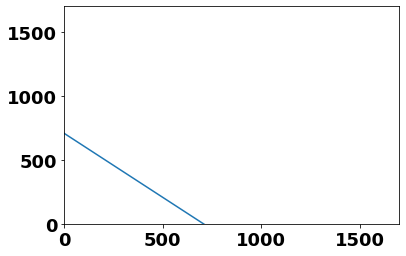

In [69]:
# plot the lines...
plt.figure()
x = np.linspace(0, 1700, 1700)
#y = -x/(np.tan(ang_deg[0]*np.pi/180)) + (perp_dist[0]/np.sin(ang_deg[0]*np.pi/180))
y = -x/(np.tan(45*np.pi/180)) + (500/np.sin(45*np.pi/180))
plt.axis([0, 1700, 0, 1700])
#ax=plt.gca()                            # get the axis
#ax.set_ylim(ax.get_ylim()[::-1])        # invert the axis
#ax.xaxis.tick_top()                     # and move the X-Axis      
#ax.yaxis.set_ticks(np.arange(0, 100, 1)) # set y-ticks
#ax.yaxis.tick_left()     
plt.plot(x, y)

In [49]:
im = np.eye(9)

im[1:6, 1:6] = 1

im[-2:9, -2:9] = 1

im[0:2, -2:9] = 1

im[-3, -3] = 0

The shape of title Image = (512, 512)


<ipython-input-55-e421ca835ab7>:2: RuntimeWarning: divide by zero encountered in log
  show_img(np.log(np.abs(gaussPSF_fft_shifted)), "title", show_shape = True, shape = (10, 8), lim_enabled = False)


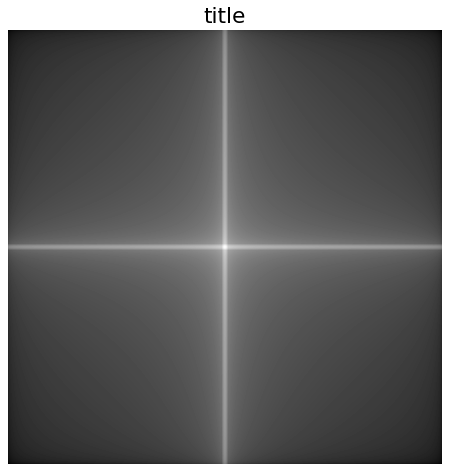

In [55]:
# Plot shifted gaussian.
show_img(np.log(np.abs(gaussPSF_fft_shifted)), "title", show_shape = True, shape = (10, 8), lim_enabled = False)